<a href="https://colab.research.google.com/github/emileDesmaili/DeepLIIF/blob/main/deeplite.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Experiments with DeepLIIF-like models

author: Emile Esmaili (ede2110@columbia.edu)

# !Preliminaries

- download the training, validation and testing data [here](https://zenodo.org/record/4751737#.ZFE2OnbMKUl) - I personally used the 'BC' files

- put them in your google drive

# imports

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision.transforms as transforms
import torchvision.datasets as datasets
from tqdm import tqdm
import torchvision.transforms.functional as TF
import numpy as np

import matplotlib.pyplot as plt
import torchvision.transforms as transforms
from PIL import Image
import torchvision 
from torch.utils.data import Dataset, DataLoader

import os

!pip install git+https://github.com/huggingface/diffusers.git
!pip install accelerate

import requests
from PIL import Image
from io import BytesIO
from diffusers import LDMSuperResolutionPipeline

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Cloning https://github.com/huggingface/diffusers.git to /tmp/pip-req-build-k8q1jm3h
  Running command git clone --filter=blob:none --quiet https://github.com/huggingface/diffusers.git /tmp/pip-req-build-k8q1jm3h
  Resolved https://github.com/huggingface/diffusers.git to commit 79c0e24a1442741c59c9b1d2764ba4dbfe56ac71
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 224.5/224.5 kB 5.8 MB/s eta 0:00:00
  Created wheel for diffusers: filename=diffusers-0.17.0.dev0-py3-none-any.whl size=959783 sha256=44984fcf5bfc282298514b8fb93376aaeb9bb4465f9c9ce5071bc9206b6f465d
  Stored in directory: /tmp/pip-ephem-wheel-cache-ay0fjr0_/wheels/4d/b7/a8/6f9549ceec5daad78675b857ac57d697c387062506520a7b50
Successfully built diffusers
Looking in indexes: https://pypi.org/simple, h

In [ ]:
from google.colab import drive
drive.mount('/content/drive')


Mounted at /content/drive


In [ ]:
# Set device
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')


# Data loading

In [ ]:

os.chdir('/content/drive/MyDrive/Columbia/Deepliif/data')  # CHANGE THIS to the directory with zip files

# Set the base directory for the data
base_dir = '/content/drive/MyDrive/Columbia/Deepliif/data'

# # Extract the train, val, and test zip files 
first_run = False  # CHANGE THIS if first run
if first_run==True:
  import zipfile
  with zipfile.ZipFile(f'{base_dir}/BC-DeepLIIF_Training_Set.zip', 'r') as zip_ref:
      zip_ref.extractall(f'{base_dir}/train')
  with zipfile.ZipFile(f'{base_dir}/BC-DeepLIIF_Validation_Set.zip', 'r') as zip_ref:
      zip_ref.extractall(f'{base_dir}/val')
  with zipfile.ZipFile(f'{base_dir}/DeepLIIF_Testing_Set.zip', 'r') as zip_ref:
      zip_ref.extractall(f'{base_dir}/test')


In [ ]:
train_dir = base_dir+'/train/BC-DeepLIIF_Training_Set'
val_dir = base_dir+'/val/BC-DeepLIIF_Validation_Set'
test_dir = base_dir +'/test/DeepLIIF_Testing_Set'


In [ ]:
train_dir

'/content/drive/MyDrive/Columbia/Deepliif/data/train/BC-DeepLIIF_Training_Set'

#1. AE model

In [ ]:
class ImageDataset(Dataset):
    def __init__(self, root_dir, transform=None):
        self.root_dir = root_dir
        self.transform = transform
        self.image_filenames = os.listdir(root_dir)

    def __len__(self):
        return len(self.image_filenames)

    def __getitem__(self, index):
        # Load the concatenated image
        image_filename = self.image_filenames[index]
        image_path = os.path.join(self.root_dir, image_filename)
        image = Image.open(image_path).convert('RGB')
        size = 512

        # Split the image into x and 4 y's
        x = image.crop((0, 0, size, size))
        y1 = image.crop((size, 0, size*2, size))
        y2 = image.crop((size*2, 0, size*3, size))
        y3 = image.crop((size*3, 0, size*4, size))
        y4 = image.crop((size*4, 0, size*5, size))
        y5 = image.crop((size*5, 0, size*6, size))


        # Apply transformations to x and y's if provided
        if self.transform:
            x = self.transform(x)
            y1 = self.transform(y1)
            y2 = self.transform(y2)
            y3 = self.transform(y3)
            y4 = self.transform(y4)
            y5 = self.transform(y5)

        y = y3
        # Return x and 4 y's as a tuple
        return x, y

# Define transformations to apply to the images
transform = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.ToTensor(),
    #transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
])


batch_size = 16
# Create the datasets and dataloaders
train_dataset = ImageDataset(train_dir, transform=transform)
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)

val_dataset = ImageDataset(val_dir, transform=transform)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

test_dataset = ImageDataset(test_dir, transform=transform)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)


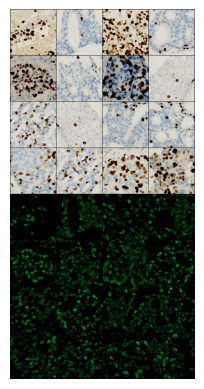

In [ ]:
# get one random sample from the dataloader
#x, y1,y2,y3,y4,y5 = next(iter(train_loader))
x, y = next(iter(train_loader))

# Concatenate the images horizontally
#images = torchvision.utils.make_grid(torch.cat([x, y1, y2, y3, y4, y5], dim=0), nrow=6)
images = torchvision.utils.make_grid(torch.cat([x,y], dim=0), nrow=4)

# Transpose the tensor to convert it from (C, H, W) to (H, W, C) format for plotting
images = images.permute(1, 2, 0)

# Plot the images
plt.imshow(images)
plt.axis('off')
plt.show()

## Model Architectures

In [ ]:
import torch.nn as nn
import torchvision.models as models

class Autoencoder(nn.Module):
    def __init__(self, freeze_encoder=True):
        super(Autoencoder, self).__init__()
        
        # Load the pretrained encoder
        prenet = models.resnet50(pretrained=True)
        self.encoder = nn.Sequential(*list(prenet.children())[:-1])
        
        # Freeze the encoder parameters if specified
        if freeze_encoder:
            for param in self.encoder.parameters():
                param.requires_grad = False

        # Define the decoder with batch normalization
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(2048, 1024, kernel_size=4, stride=2, padding=1),
            #nn.BatchNorm2d(1024),
            nn.ReLU(),
            nn.ConvTranspose2d(1024, 512, kernel_size=4, stride=2, padding=1),
            #nn.BatchNorm2d(512),
            nn.ReLU(),
            nn.ConvTranspose2d(512, 256, kernel_size=4, stride=2, padding=1),
            #nn.BatchNorm2d(256),
            nn.ReLU(),
            nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1),
            #nn.BatchNorm2d(128),
            nn.ReLU(),
            nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1),
            #nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.ConvTranspose2d(64, 32, kernel_size=4, stride=2, padding=1),
            #nn.BatchNorm2d(32),
            nn.ReLU(),
            nn.ConvTranspose2d(32, 16, kernel_size=4, stride=2, padding=1),
            #nn.BatchNorm2d(16),
            nn.ReLU(),
            nn.ConvTranspose2d(16, 3, kernel_size=4, stride=2, padding=1),
            nn.Tanh()
        )
         
    def forward(self, x):
        # Encode the input x using ResNet50
        with torch.no_grad():
          encoded = self.encoder(x)
        # Decode the encoded output to produce y1
        y = self.decoder(encoded)
        
        return y


In [ ]:
model = Autoencoder()
input = torch.randn([batch_size,3,256,256])
output = model(input)
output.shape

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 386MB/s]


torch.Size([16, 3, 256, 256])

## Training utils

In [ ]:
# define a function to plot images
def plot_images(model_output, base_image, true_image):
    fig, axs = plt.subplots(1, 3)

    axs[0].imshow(model_output.permute(1, 2, 0).cpu().detach().numpy())
    axs[0].set_title('Model output')
    axs[1].imshow(true_image.permute(1, 2, 0).cpu().detach().numpy())
    axs[1].set_title('True image')
    axs[2].imshow(base_image.permute(1, 2, 0).cpu().detach().numpy())
    axs[2].set_title('Base image')
    plt.show()


In [ ]:
# Training loop

# create the models directory if it doesn't exist
save_dir = '/content/drive/MyDrive/Columbia/Deepliif/models/deeplite'


def train(model, train_loader, criterion, optimizer, device):
    model.train()
    train_loss = 0

    for i, (x, y) in tqdm(enumerate(train_loader)):
        x = x.to(device)
        y = y.to(device)

        # Forward pass
        y_pred = model(x)
        loss = criterion(y_pred, y)

        # Backward pass and optimization
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        if i==0:
          plot_images(y_pred[0,:,:,:],x[0,:,:,:], y[0,:,:,:])

        train_loss += loss.item()

    return train_loss / len(train_loader)

def validate(model, val_loader, criterion, device):
    model.eval()
    val_loss = 0

    with torch.no_grad():
        for i, (x, y) in enumerate(val_loader):
            x = x.to(device)
            y = y.to(device)
            

            # Forward pass
            y_pred = model(x)
            loss = criterion(y_pred, y)


            val_loss += loss.item()

    return val_loss / len(val_loader)




## Training

In [ ]:
# Initialize model, optimizer, criterion, and dataloaders
model = Autoencoder()
optimizer = torch.optim.Adam(model.parameters(), lr=1e-3)
criterion = nn.HuberLoss()
#criterion = nn.L1Loss()
# define variables to keep track of the best model and best validation loss
best_model = None
best_val_loss = float('inf')


model.to(device)
criterion.to(device)

# Train and validate loop
all_train_loss, all_val_loss = [], []

0it [00:00, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


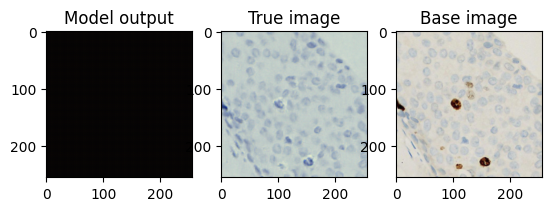

25it [00:29,  1.19s/it]


Epoch [1/200], Train Loss: 0.0999, Validation Loss: 0.0327


0it [00:00, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


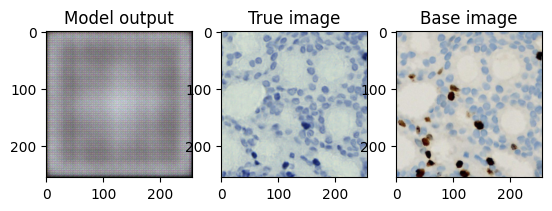

25it [00:26,  1.08s/it]


Epoch [2/200], Train Loss: 0.0155, Validation Loss: 0.0100


0it [00:00, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


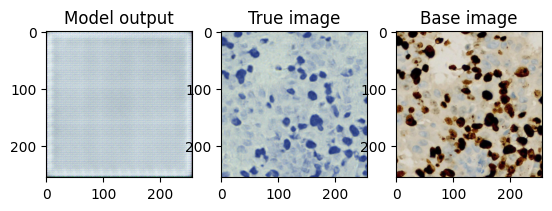

25it [00:26,  1.08s/it]


Epoch [3/200], Train Loss: 0.0092, Validation Loss: 0.0085


0it [00:00, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


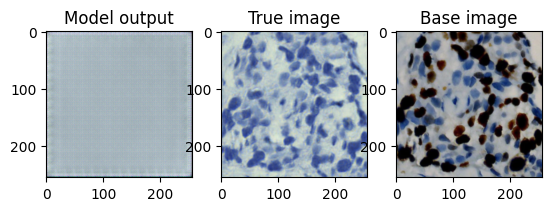

25it [00:26,  1.07s/it]


Epoch [4/200], Train Loss: 0.0084, Validation Loss: 0.0099


0it [00:00, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


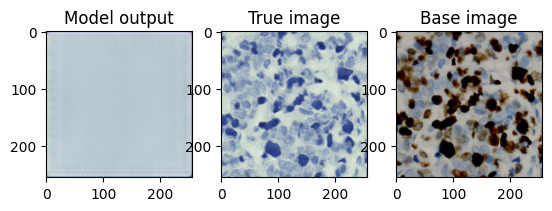

25it [00:25,  1.03s/it]


Epoch [5/200], Train Loss: 0.0077, Validation Loss: 0.0096


0it [00:00, ?it/s]

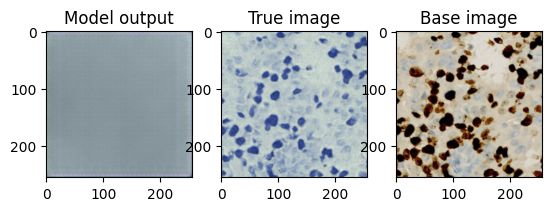

25it [00:25,  1.03s/it]


Epoch [6/200], Train Loss: 0.0082, Validation Loss: 0.0069


0it [00:00, ?it/s]

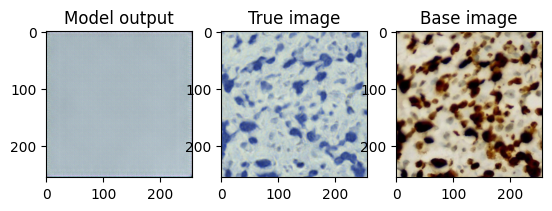

25it [00:27,  1.10s/it]


Epoch [7/200], Train Loss: 0.0073, Validation Loss: 0.0061


0it [00:00, ?it/s]

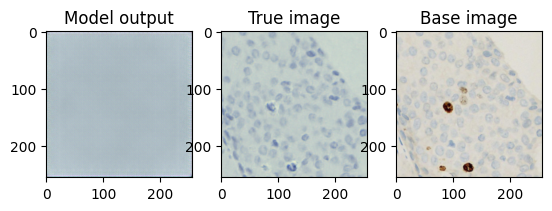

25it [00:27,  1.09s/it]


Epoch [8/200], Train Loss: 0.0077, Validation Loss: 0.0066


0it [00:00, ?it/s]

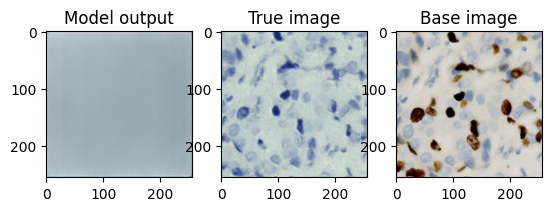

25it [00:26,  1.04s/it]


Epoch [9/200], Train Loss: 0.0071, Validation Loss: 0.0059


0it [00:00, ?it/s]

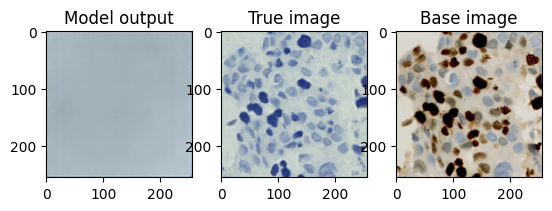

25it [00:26,  1.07s/it]


Epoch [10/200], Train Loss: 0.0068, Validation Loss: 0.0058


0it [00:00, ?it/s]

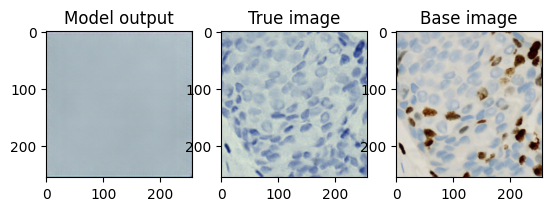

25it [00:27,  1.09s/it]


Epoch [11/200], Train Loss: 0.0069, Validation Loss: 0.0057


0it [00:00, ?it/s]

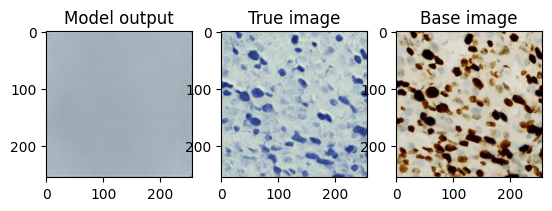

25it [00:26,  1.06s/it]


Epoch [12/200], Train Loss: 0.0074, Validation Loss: 0.0072


0it [00:00, ?it/s]

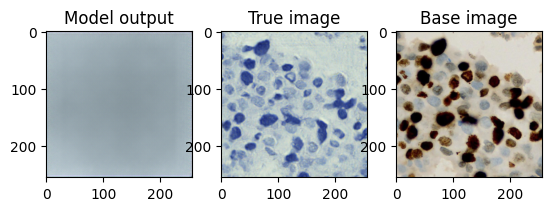

25it [00:25,  1.02s/it]


Epoch [13/200], Train Loss: 0.0070, Validation Loss: 0.0064


0it [00:00, ?it/s]

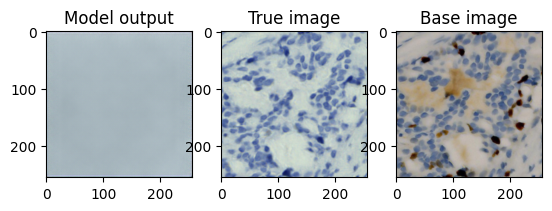

25it [00:25,  1.04s/it]


Epoch [14/200], Train Loss: 0.0069, Validation Loss: 0.0056


0it [00:00, ?it/s]

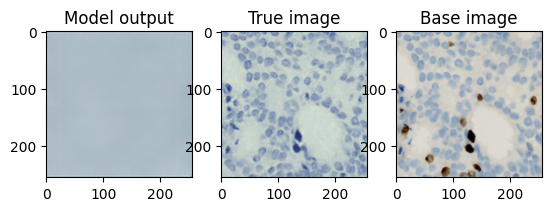

25it [00:27,  1.08s/it]


Epoch [15/200], Train Loss: 0.0066, Validation Loss: 0.0062


0it [00:00, ?it/s]

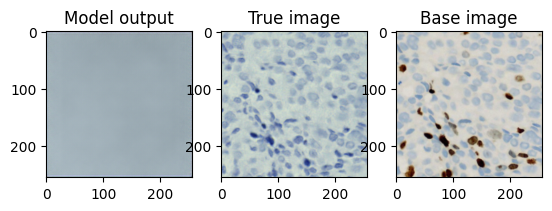

25it [00:26,  1.06s/it]


Epoch [16/200], Train Loss: 0.0067, Validation Loss: 0.0056


0it [00:00, ?it/s]

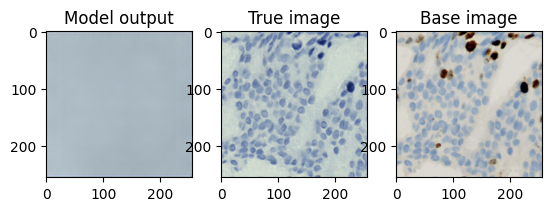

25it [00:26,  1.07s/it]


Epoch [17/200], Train Loss: 0.0067, Validation Loss: 0.0060


0it [00:00, ?it/s]

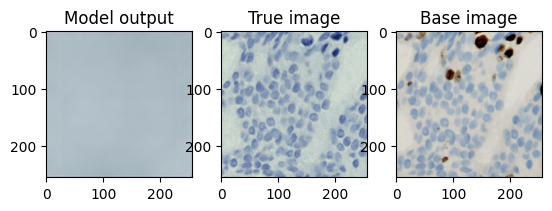

25it [00:26,  1.08s/it]


Epoch [18/200], Train Loss: 0.0066, Validation Loss: 0.0055


0it [00:00, ?it/s]

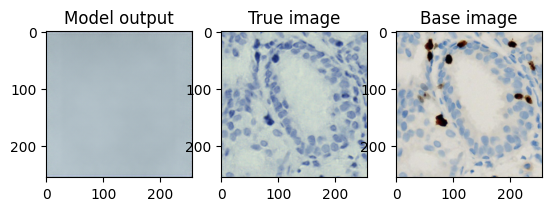

25it [00:27,  1.09s/it]


Epoch [19/200], Train Loss: 0.0065, Validation Loss: 0.0059


0it [00:00, ?it/s]

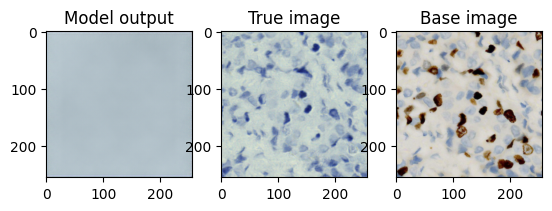

25it [00:26,  1.06s/it]


Epoch [20/200], Train Loss: 0.0066, Validation Loss: 0.0073


0it [00:00, ?it/s]

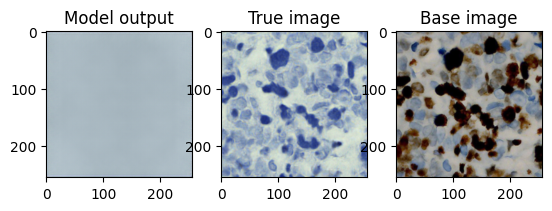

25it [00:26,  1.05s/it]


Epoch [21/200], Train Loss: 0.0075, Validation Loss: 0.0059


0it [00:00, ?it/s]

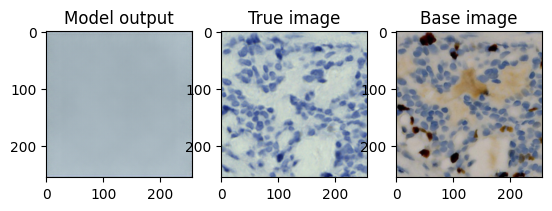

25it [00:25,  1.03s/it]


Epoch [22/200], Train Loss: 0.0064, Validation Loss: 0.0078


0it [00:00, ?it/s]

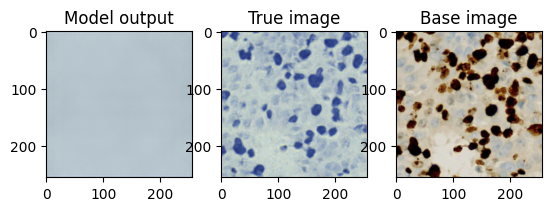

25it [00:26,  1.07s/it]


Epoch [23/200], Train Loss: 0.0067, Validation Loss: 0.0057


0it [00:00, ?it/s]

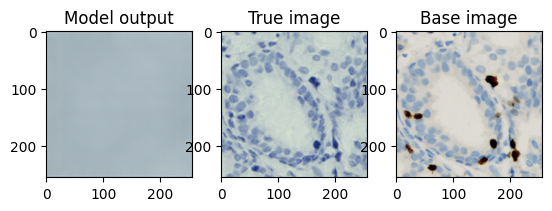

25it [00:26,  1.08s/it]


Epoch [24/200], Train Loss: 0.0063, Validation Loss: 0.0061


0it [00:00, ?it/s]

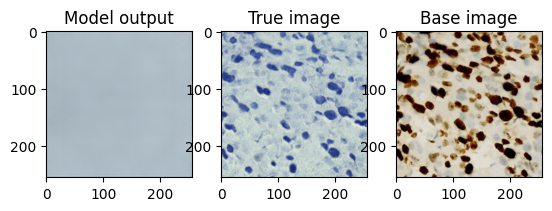

25it [00:27,  1.08s/it]


Epoch [25/200], Train Loss: 0.0069, Validation Loss: 0.0080


0it [00:00, ?it/s]

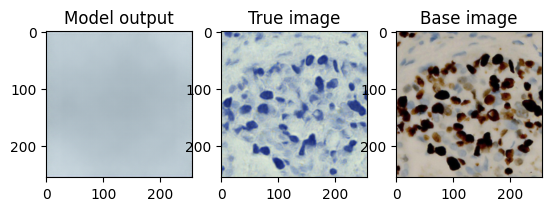

25it [00:26,  1.07s/it]


Epoch [26/200], Train Loss: 0.0070, Validation Loss: 0.0064


0it [00:00, ?it/s]

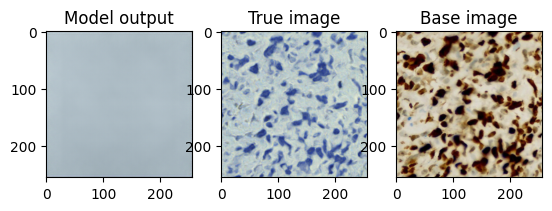

25it [00:26,  1.06s/it]


Epoch [27/200], Train Loss: 0.0068, Validation Loss: 0.0062


0it [00:00, ?it/s]

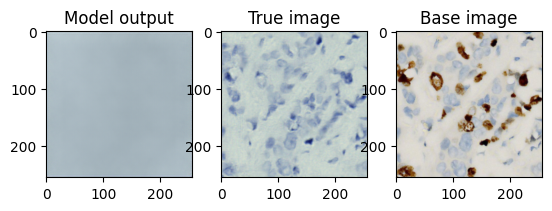

25it [00:26,  1.08s/it]


Epoch [28/200], Train Loss: 0.0065, Validation Loss: 0.0070


0it [00:00, ?it/s]

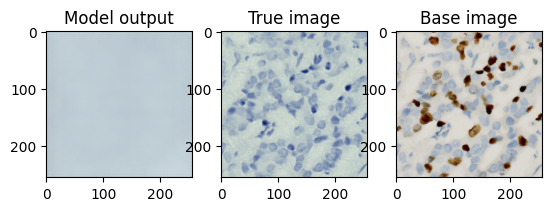

25it [00:26,  1.07s/it]


Epoch [29/200], Train Loss: 0.0067, Validation Loss: 0.0061


0it [00:00, ?it/s]

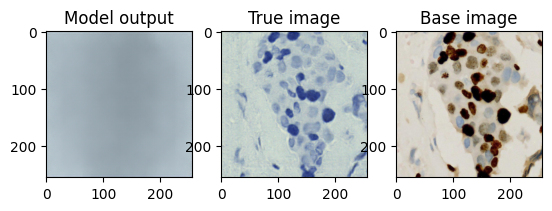

25it [00:26,  1.06s/it]


Epoch [30/200], Train Loss: 0.0067, Validation Loss: 0.0073


0it [00:00, ?it/s]

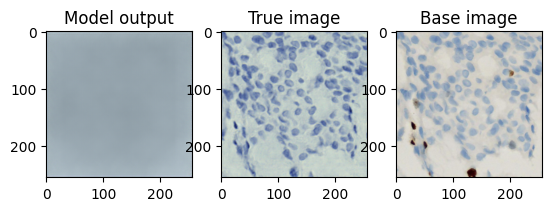

25it [00:27,  1.08s/it]


Epoch [31/200], Train Loss: 0.0067, Validation Loss: 0.0064


0it [00:00, ?it/s]

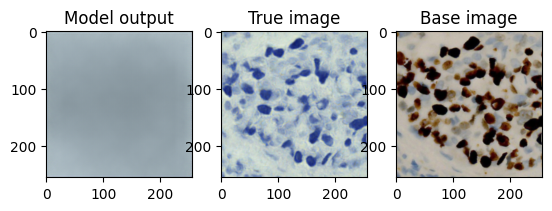

25it [00:26,  1.05s/it]


Epoch [32/200], Train Loss: 0.0065, Validation Loss: 0.0059


0it [00:00, ?it/s]

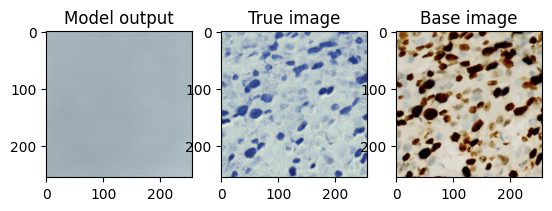

25it [00:26,  1.07s/it]


Epoch [33/200], Train Loss: 0.0066, Validation Loss: 0.0055


0it [00:00, ?it/s]

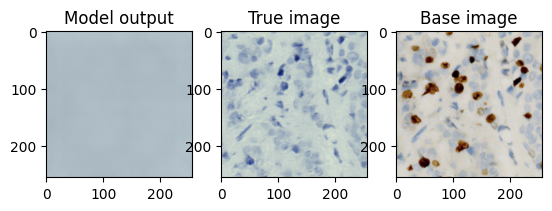

25it [00:27,  1.10s/it]


Epoch [34/200], Train Loss: 0.0065, Validation Loss: 0.0056


0it [00:00, ?it/s]

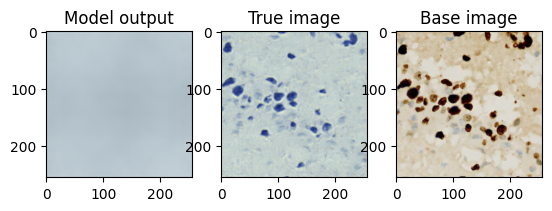

25it [00:26,  1.08s/it]


Epoch [35/200], Train Loss: 0.0062, Validation Loss: 0.0055


0it [00:00, ?it/s]

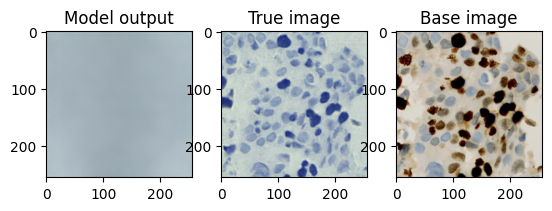

25it [00:27,  1.08s/it]


Epoch [36/200], Train Loss: 0.0063, Validation Loss: 0.0055


0it [00:00, ?it/s]

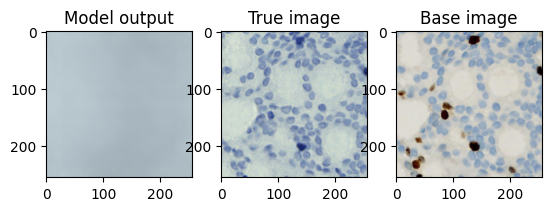

25it [00:28,  1.12s/it]


Epoch [37/200], Train Loss: 0.0064, Validation Loss: 0.0066


0it [00:00, ?it/s]

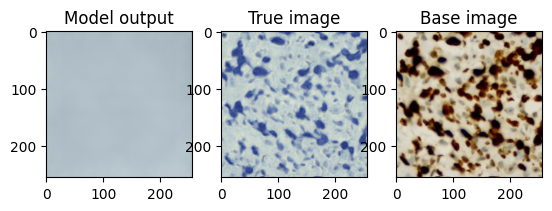

25it [00:27,  1.08s/it]


Epoch [38/200], Train Loss: 0.0064, Validation Loss: 0.0081


0it [00:00, ?it/s]

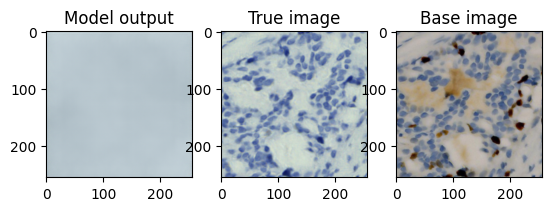

25it [00:26,  1.08s/it]


Epoch [39/200], Train Loss: 0.0066, Validation Loss: 0.0070


0it [00:00, ?it/s]

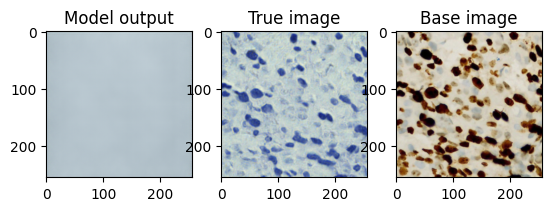

25it [00:26,  1.08s/it]


Epoch [40/200], Train Loss: 0.0067, Validation Loss: 0.0058


0it [00:00, ?it/s]

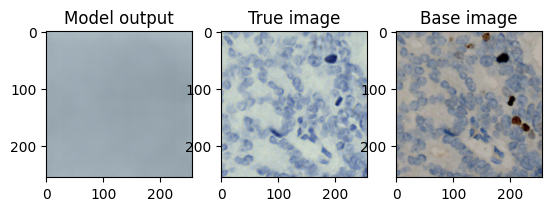

25it [00:26,  1.06s/it]


Epoch [41/200], Train Loss: 0.0067, Validation Loss: 0.0060


0it [00:00, ?it/s]

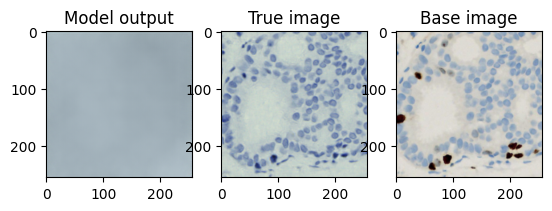

25it [00:27,  1.09s/it]


Epoch [42/200], Train Loss: 0.0064, Validation Loss: 0.0058


0it [00:00, ?it/s]

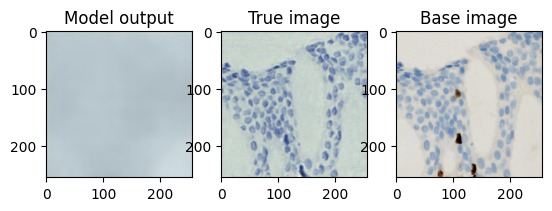

25it [00:27,  1.09s/it]


Epoch [43/200], Train Loss: 0.0064, Validation Loss: 0.0057


0it [00:00, ?it/s]

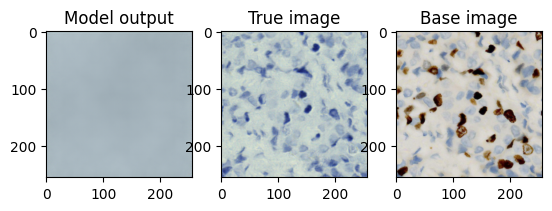

25it [00:27,  1.08s/it]


Epoch [44/200], Train Loss: 0.0063, Validation Loss: 0.0055


0it [00:00, ?it/s]

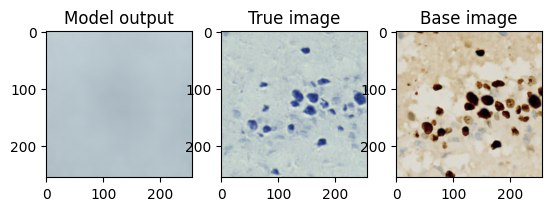

25it [00:27,  1.12s/it]


Epoch [45/200], Train Loss: 0.0064, Validation Loss: 0.0055


0it [00:00, ?it/s]

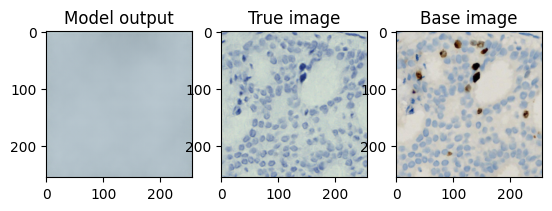

25it [00:28,  1.14s/it]


Epoch [46/200], Train Loss: 0.0064, Validation Loss: 0.0055


0it [00:00, ?it/s]

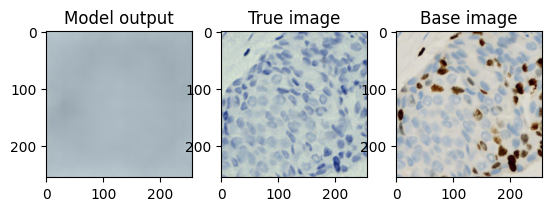

25it [00:27,  1.10s/it]


Epoch [47/200], Train Loss: 0.0065, Validation Loss: 0.0060


0it [00:00, ?it/s]

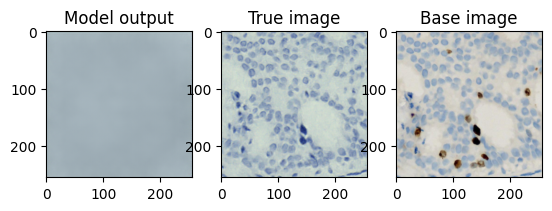

25it [00:27,  1.08s/it]


Epoch [48/200], Train Loss: 0.0069, Validation Loss: 0.0060


0it [00:00, ?it/s]

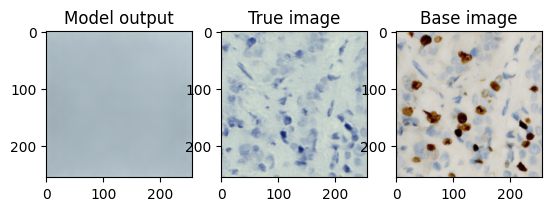

25it [00:27,  1.10s/it]


Epoch [49/200], Train Loss: 0.0065, Validation Loss: 0.0058


0it [00:00, ?it/s]

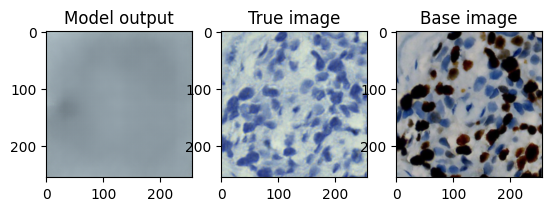

25it [00:27,  1.11s/it]


Epoch [50/200], Train Loss: 0.0063, Validation Loss: 0.0056


0it [00:00, ?it/s]

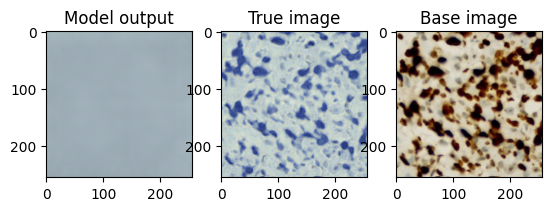

25it [00:27,  1.08s/it]


Epoch [51/200], Train Loss: 0.0064, Validation Loss: 0.0058


0it [00:00, ?it/s]

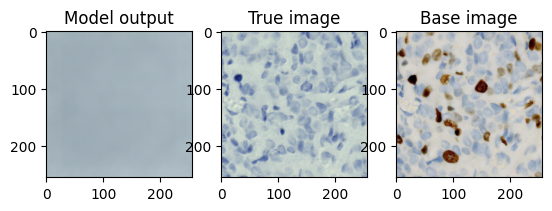

25it [00:27,  1.09s/it]


Epoch [52/200], Train Loss: 0.0064, Validation Loss: 0.0063


0it [00:00, ?it/s]

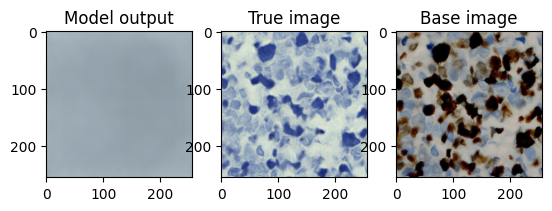

25it [00:26,  1.07s/it]


Epoch [53/200], Train Loss: 0.0067, Validation Loss: 0.0056


0it [00:00, ?it/s]

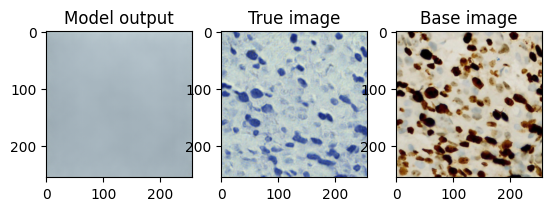

25it [00:27,  1.09s/it]


Epoch [54/200], Train Loss: 0.0064, Validation Loss: 0.0056


0it [00:00, ?it/s]

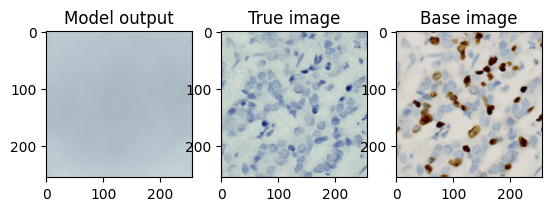

25it [00:27,  1.08s/it]


Epoch [55/200], Train Loss: 0.0061, Validation Loss: 0.0056


0it [00:00, ?it/s]

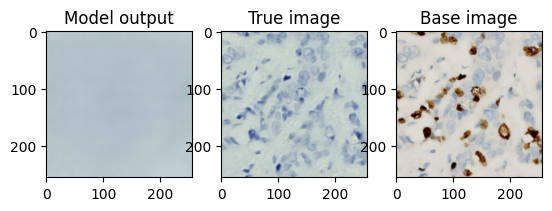

25it [00:27,  1.08s/it]


Epoch [56/200], Train Loss: 0.0062, Validation Loss: 0.0057


0it [00:00, ?it/s]

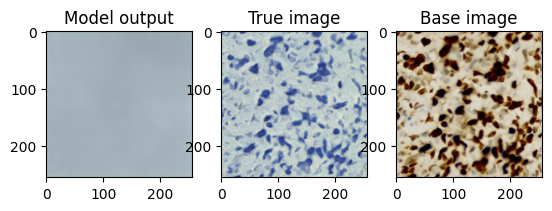

25it [00:27,  1.09s/it]


Epoch [57/200], Train Loss: 0.0063, Validation Loss: 0.0058


0it [00:00, ?it/s]

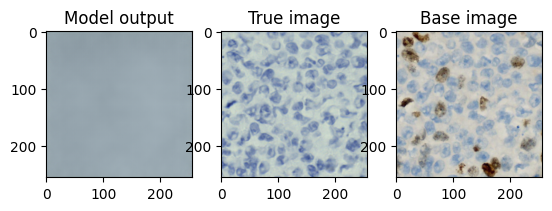

25it [00:26,  1.07s/it]


Epoch [58/200], Train Loss: 0.0061, Validation Loss: 0.0056


0it [00:00, ?it/s]

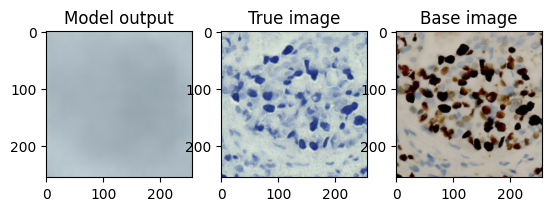

25it [00:26,  1.06s/it]


Epoch [59/200], Train Loss: 0.0063, Validation Loss: 0.0055


0it [00:00, ?it/s]

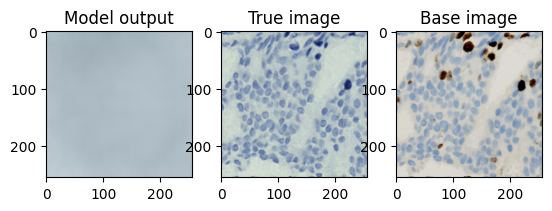

25it [00:26,  1.08s/it]


Epoch [60/200], Train Loss: 0.0061, Validation Loss: 0.0054


0it [00:00, ?it/s]

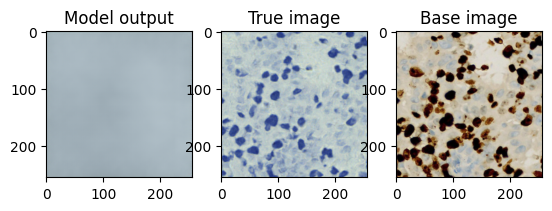

25it [00:27,  1.10s/it]


Epoch [61/200], Train Loss: 0.0061, Validation Loss: 0.0056


0it [00:00, ?it/s]

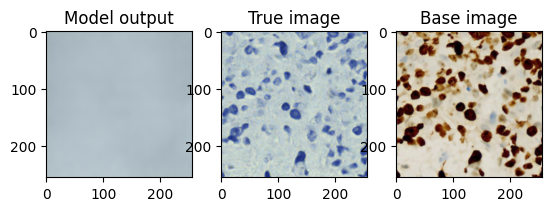

25it [00:27,  1.08s/it]


Epoch [62/200], Train Loss: 0.0063, Validation Loss: 0.0055


0it [00:00, ?it/s]

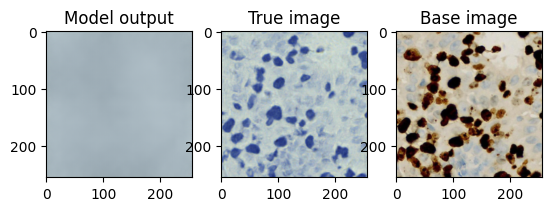

25it [00:26,  1.05s/it]


Epoch [63/200], Train Loss: 0.0065, Validation Loss: 0.0055


0it [00:00, ?it/s]

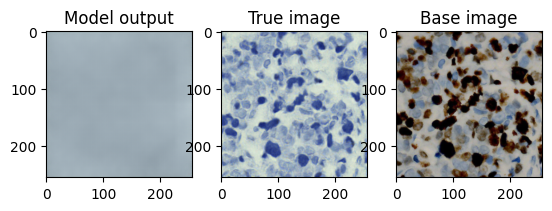

25it [00:26,  1.06s/it]


Epoch [64/200], Train Loss: 0.0066, Validation Loss: 0.0056


0it [00:00, ?it/s]

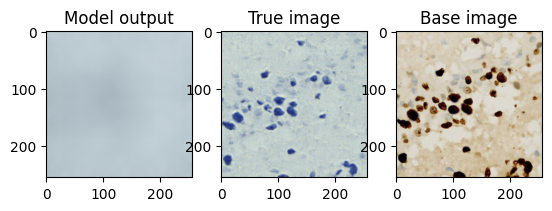

25it [00:27,  1.09s/it]


Epoch [65/200], Train Loss: 0.0063, Validation Loss: 0.0056


0it [00:00, ?it/s]

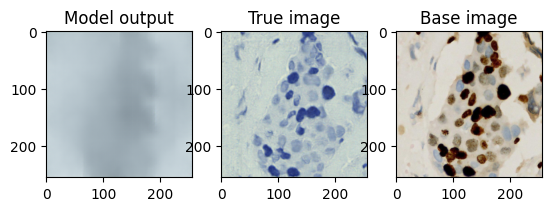

25it [00:26,  1.07s/it]


Epoch [66/200], Train Loss: 0.0062, Validation Loss: 0.0059


0it [00:00, ?it/s]

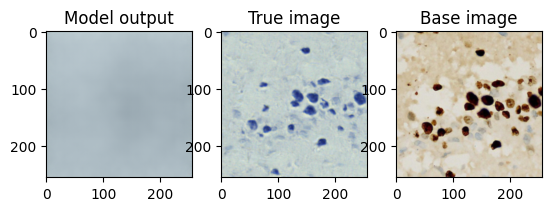

25it [00:26,  1.07s/it]


Epoch [67/200], Train Loss: 0.0063, Validation Loss: 0.0060


0it [00:00, ?it/s]

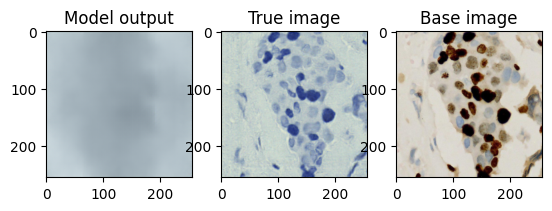

25it [00:26,  1.08s/it]


Epoch [68/200], Train Loss: 0.0062, Validation Loss: 0.0056


0it [00:00, ?it/s]

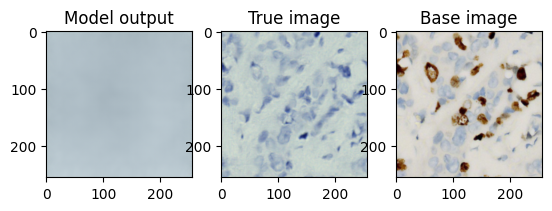

25it [00:26,  1.04s/it]


Epoch [69/200], Train Loss: 0.0062, Validation Loss: 0.0071


0it [00:00, ?it/s]

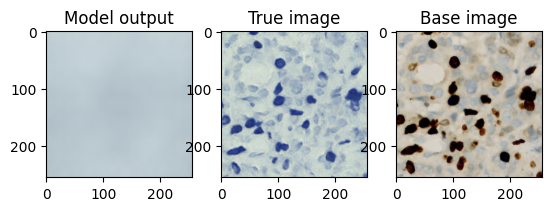

25it [00:26,  1.08s/it]


Epoch [70/200], Train Loss: 0.0072, Validation Loss: 0.0066


0it [00:00, ?it/s]

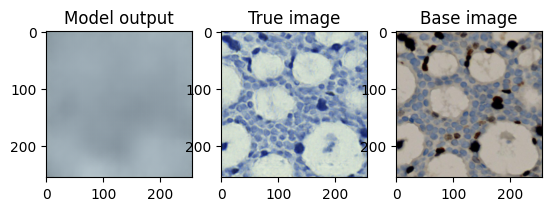

25it [00:26,  1.07s/it]


Epoch [71/200], Train Loss: 0.0066, Validation Loss: 0.0055


0it [00:00, ?it/s]

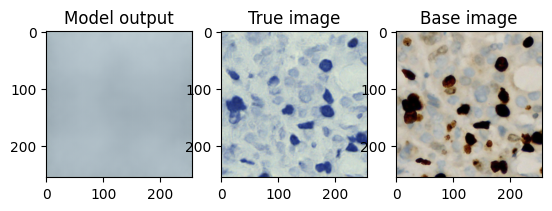

25it [00:28,  1.13s/it]


Epoch [72/200], Train Loss: 0.0061, Validation Loss: 0.0055


0it [00:00, ?it/s]

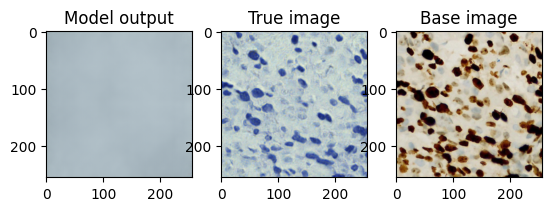

25it [00:28,  1.15s/it]


Epoch [73/200], Train Loss: 0.0061, Validation Loss: 0.0056


0it [00:00, ?it/s]

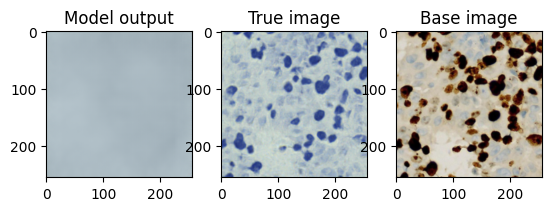

25it [00:27,  1.12s/it]


Epoch [74/200], Train Loss: 0.0062, Validation Loss: 0.0055


0it [00:00, ?it/s]

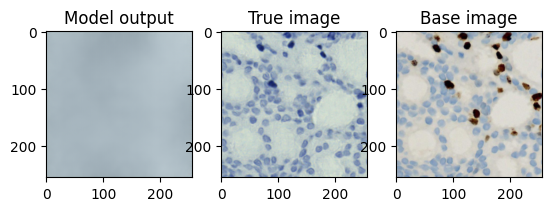

25it [00:27,  1.11s/it]


Epoch [75/200], Train Loss: 0.0063, Validation Loss: 0.0058


0it [00:00, ?it/s]

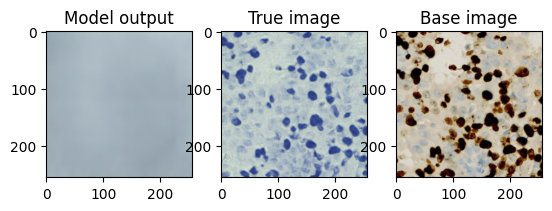

25it [00:27,  1.11s/it]


Epoch [76/200], Train Loss: 0.0059, Validation Loss: 0.0055


0it [00:00, ?it/s]

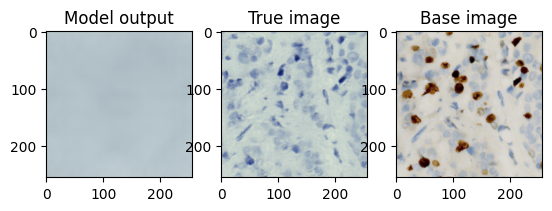

25it [00:27,  1.11s/it]


Epoch [77/200], Train Loss: 0.0060, Validation Loss: 0.0057


0it [00:00, ?it/s]

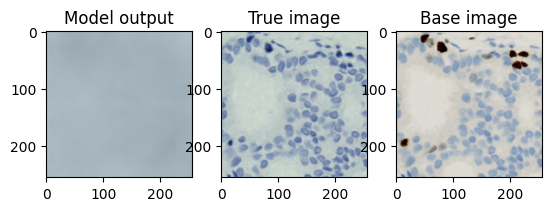

25it [00:27,  1.11s/it]


Epoch [78/200], Train Loss: 0.0059, Validation Loss: 0.0059


0it [00:00, ?it/s]

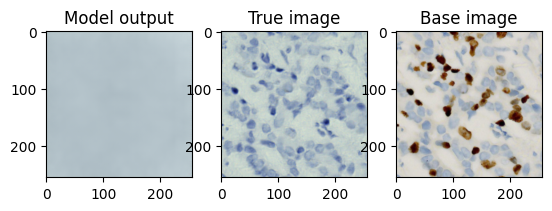

25it [00:27,  1.10s/it]


Epoch [79/200], Train Loss: 0.0062, Validation Loss: 0.0062


0it [00:00, ?it/s]

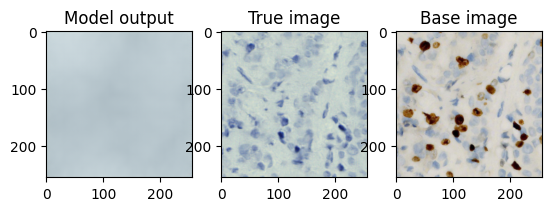

25it [00:28,  1.15s/it]


Epoch [80/200], Train Loss: 0.0063, Validation Loss: 0.0056


0it [00:00, ?it/s]

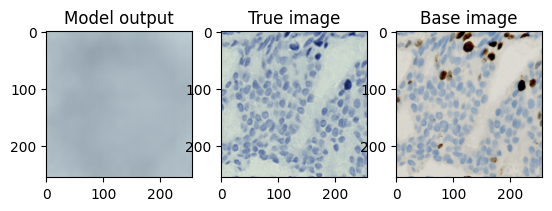

25it [00:28,  1.13s/it]


Epoch [81/200], Train Loss: 0.0059, Validation Loss: 0.0057


0it [00:00, ?it/s]

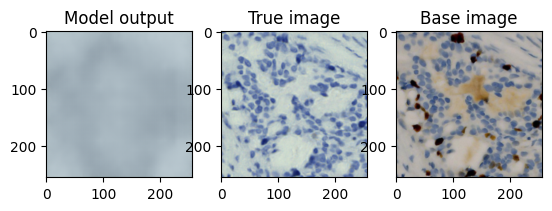

25it [00:27,  1.12s/it]


Epoch [82/200], Train Loss: 0.0058, Validation Loss: 0.0063


0it [00:00, ?it/s]

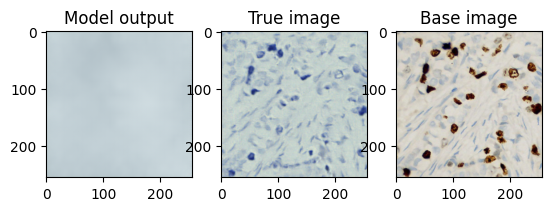

25it [00:27,  1.12s/it]


Epoch [83/200], Train Loss: 0.0064, Validation Loss: 0.0062


0it [00:00, ?it/s]

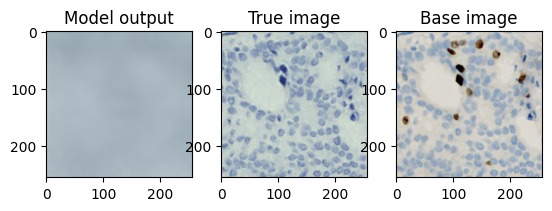

25it [00:28,  1.13s/it]


Epoch [84/200], Train Loss: 0.0062, Validation Loss: 0.0056


0it [00:00, ?it/s]

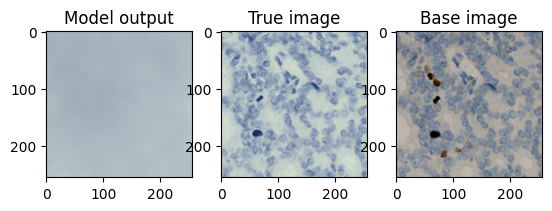

25it [00:28,  1.13s/it]


Epoch [85/200], Train Loss: 0.0059, Validation Loss: 0.0056


0it [00:00, ?it/s]

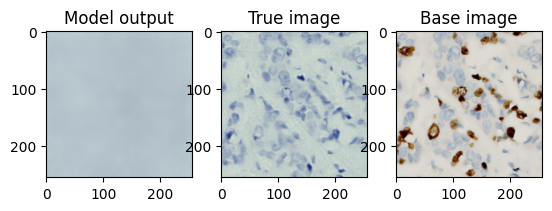

25it [00:28,  1.15s/it]


Epoch [86/200], Train Loss: 0.0058, Validation Loss: 0.0068


0it [00:00, ?it/s]

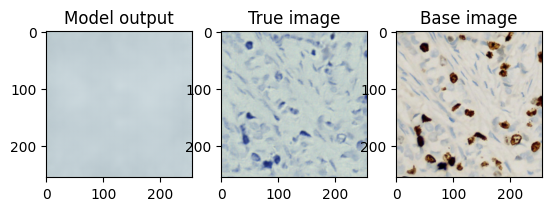

25it [00:28,  1.12s/it]


Epoch [87/200], Train Loss: 0.0062, Validation Loss: 0.0055


0it [00:00, ?it/s]

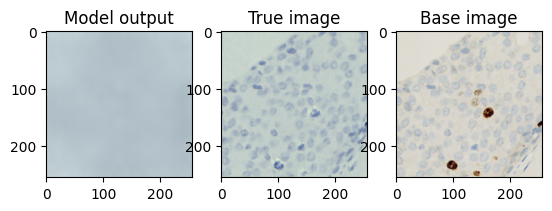

25it [00:29,  1.17s/it]


Epoch [88/200], Train Loss: 0.0059, Validation Loss: 0.0057


0it [00:00, ?it/s]

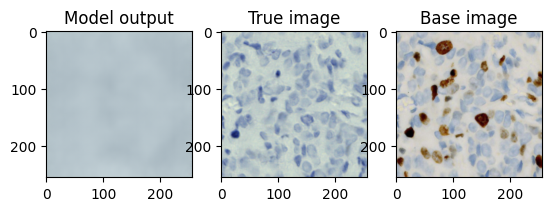

25it [00:28,  1.16s/it]


Epoch [89/200], Train Loss: 0.0060, Validation Loss: 0.0064


0it [00:00, ?it/s]

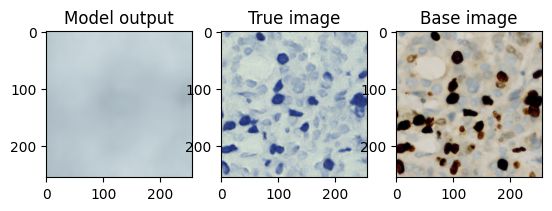

25it [00:28,  1.14s/it]


Epoch [90/200], Train Loss: 0.0063, Validation Loss: 0.0056


0it [00:00, ?it/s]

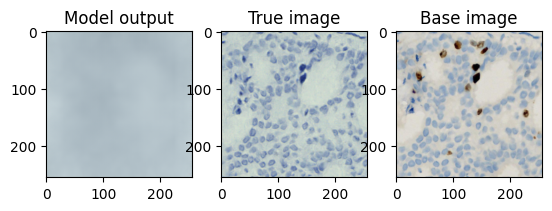

25it [00:28,  1.14s/it]


Epoch [91/200], Train Loss: 0.0059, Validation Loss: 0.0057


0it [00:00, ?it/s]

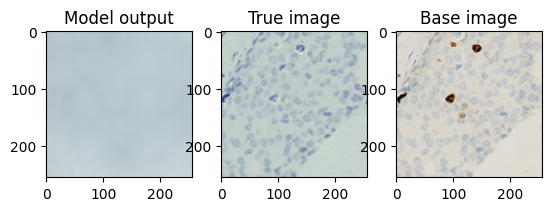

25it [00:28,  1.12s/it]


Epoch [92/200], Train Loss: 0.0058, Validation Loss: 0.0055


0it [00:00, ?it/s]

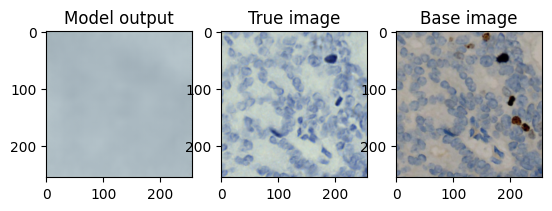

25it [00:27,  1.12s/it]


Epoch [93/200], Train Loss: 0.0058, Validation Loss: 0.0056


0it [00:00, ?it/s]

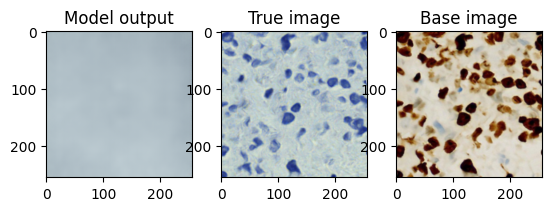

25it [00:27,  1.11s/it]


Epoch [94/200], Train Loss: 0.0061, Validation Loss: 0.0062


0it [00:00, ?it/s]

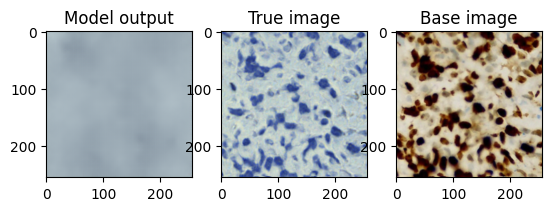

25it [00:28,  1.13s/it]


Epoch [95/200], Train Loss: 0.0059, Validation Loss: 0.0056


0it [00:00, ?it/s]

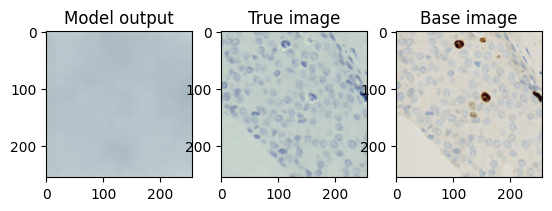

25it [00:27,  1.12s/it]


Epoch [96/200], Train Loss: 0.0057, Validation Loss: 0.0056


0it [00:00, ?it/s]

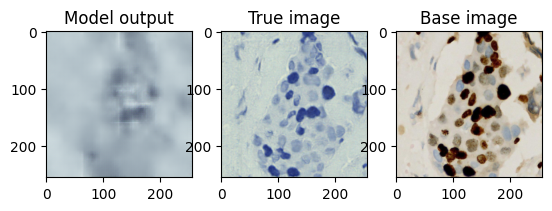

25it [00:28,  1.13s/it]


Epoch [97/200], Train Loss: 0.0057, Validation Loss: 0.0056


0it [00:00, ?it/s]

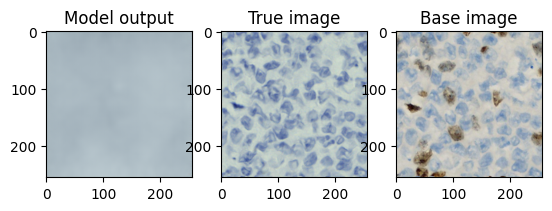

25it [00:28,  1.14s/it]


Epoch [98/200], Train Loss: 0.0057, Validation Loss: 0.0056


0it [00:00, ?it/s]

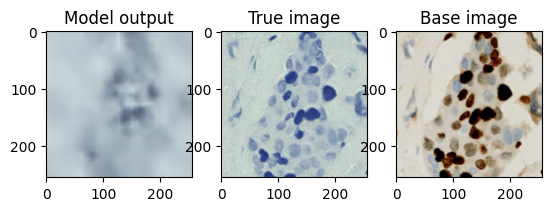

25it [00:28,  1.16s/it]


Epoch [99/200], Train Loss: 0.0056, Validation Loss: 0.0058


0it [00:00, ?it/s]

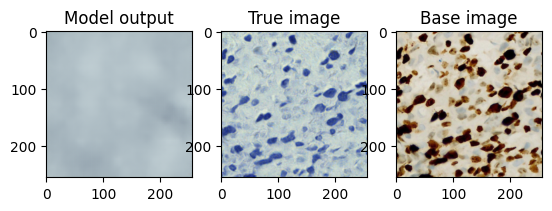

25it [00:28,  1.13s/it]


Epoch [100/200], Train Loss: 0.0059, Validation Loss: 0.0056


0it [00:00, ?it/s]

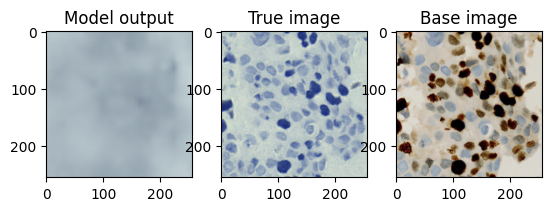

25it [00:28,  1.13s/it]


Epoch [101/200], Train Loss: 0.0059, Validation Loss: 0.0055


0it [00:00, ?it/s]

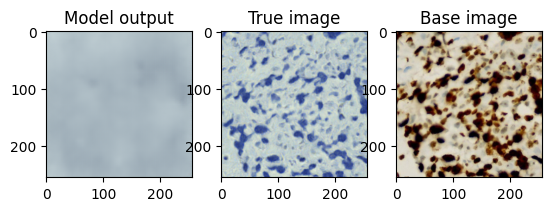

25it [00:27,  1.11s/it]


Epoch [102/200], Train Loss: 0.0056, Validation Loss: 0.0060


0it [00:00, ?it/s]

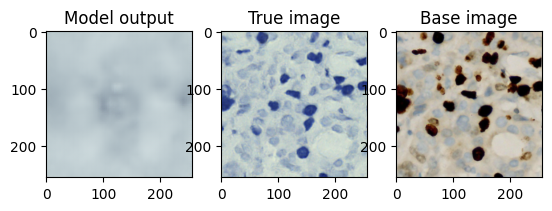

25it [00:28,  1.13s/it]


Epoch [103/200], Train Loss: 0.0058, Validation Loss: 0.0055


0it [00:00, ?it/s]

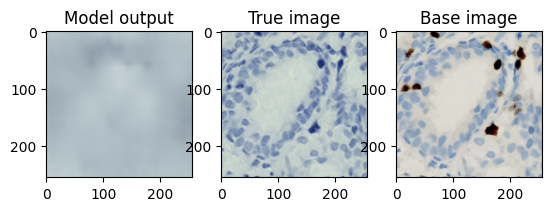

25it [00:28,  1.13s/it]


Epoch [104/200], Train Loss: 0.0056, Validation Loss: 0.0056


0it [00:00, ?it/s]

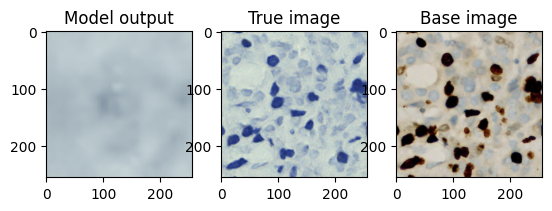

25it [00:28,  1.13s/it]


Epoch [105/200], Train Loss: 0.0057, Validation Loss: 0.0059


0it [00:00, ?it/s]

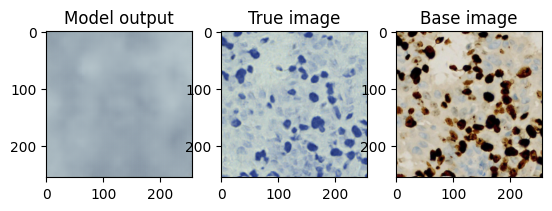

25it [00:28,  1.13s/it]


Epoch [106/200], Train Loss: 0.0056, Validation Loss: 0.0056


0it [00:00, ?it/s]

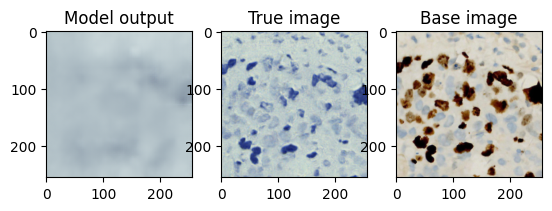

25it [00:28,  1.14s/it]


Epoch [107/200], Train Loss: 0.0058, Validation Loss: 0.0056


0it [00:00, ?it/s]

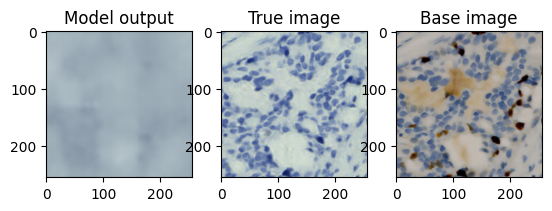

25it [00:28,  1.13s/it]


Epoch [108/200], Train Loss: 0.0057, Validation Loss: 0.0059


0it [00:00, ?it/s]

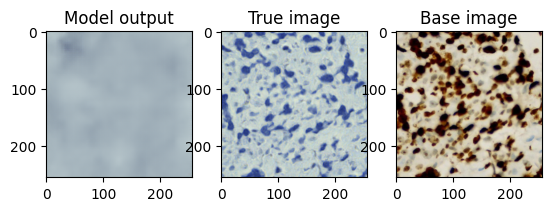

25it [00:28,  1.12s/it]


Epoch [109/200], Train Loss: 0.0054, Validation Loss: 0.0056


0it [00:00, ?it/s]

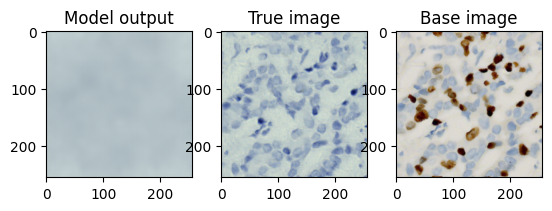

25it [00:28,  1.13s/it]


Epoch [110/200], Train Loss: 0.0055, Validation Loss: 0.0055


0it [00:00, ?it/s]

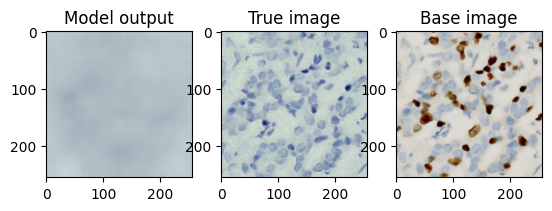

25it [00:27,  1.12s/it]


Epoch [111/200], Train Loss: 0.0054, Validation Loss: 0.0058


0it [00:00, ?it/s]

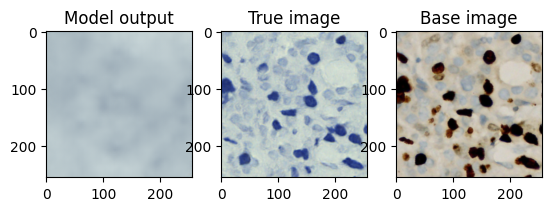

25it [00:28,  1.14s/it]


Epoch [112/200], Train Loss: 0.0054, Validation Loss: 0.0060


0it [00:00, ?it/s]

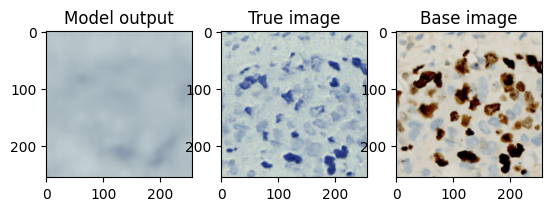

25it [00:28,  1.13s/it]


Epoch [113/200], Train Loss: 0.0057, Validation Loss: 0.0064


0it [00:00, ?it/s]

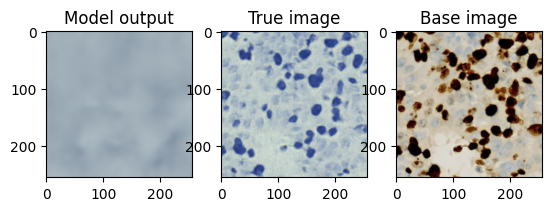

25it [00:28,  1.13s/it]


Epoch [114/200], Train Loss: 0.0055, Validation Loss: 0.0062


0it [00:00, ?it/s]

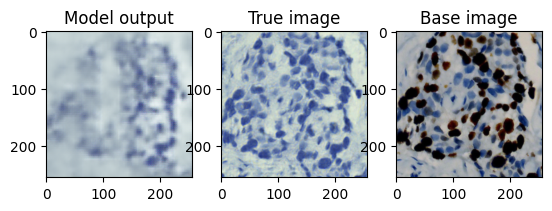

25it [00:28,  1.12s/it]


Epoch [115/200], Train Loss: 0.0057, Validation Loss: 0.0055


0it [00:00, ?it/s]

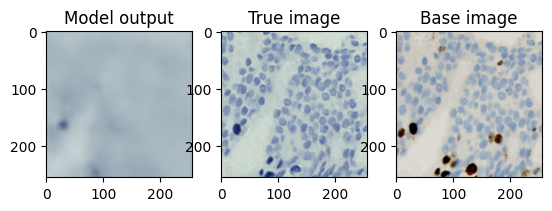

25it [00:27,  1.12s/it]


Epoch [116/200], Train Loss: 0.0053, Validation Loss: 0.0056


0it [00:00, ?it/s]

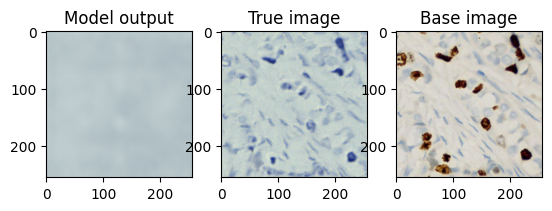

25it [00:28,  1.14s/it]


Epoch [117/200], Train Loss: 0.0054, Validation Loss: 0.0058


0it [00:00, ?it/s]

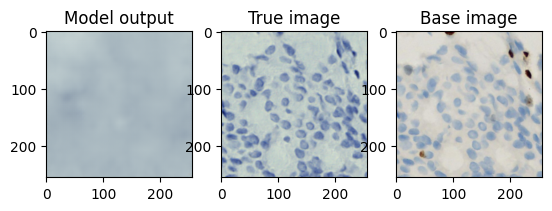

25it [00:28,  1.13s/it]


Epoch [118/200], Train Loss: 0.0054, Validation Loss: 0.0062


0it [00:00, ?it/s]

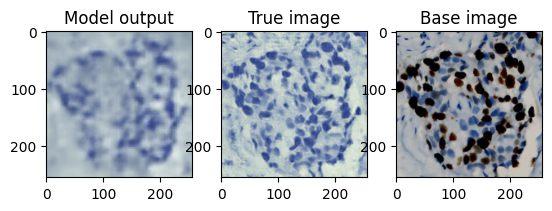

25it [00:27,  1.12s/it]


Epoch [119/200], Train Loss: 0.0052, Validation Loss: 0.0056


0it [00:00, ?it/s]

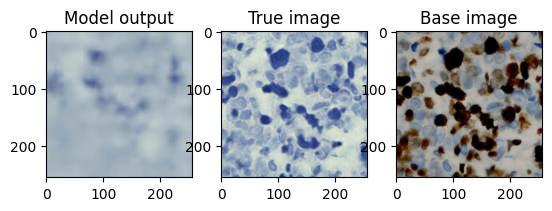

25it [00:27,  1.12s/it]


Epoch [120/200], Train Loss: 0.0053, Validation Loss: 0.0057


0it [00:00, ?it/s]

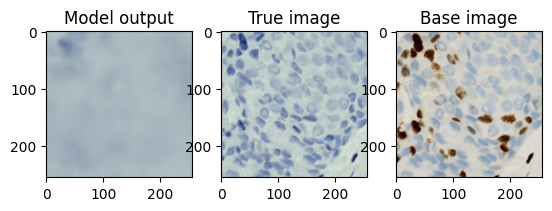

25it [00:28,  1.14s/it]


Epoch [121/200], Train Loss: 0.0051, Validation Loss: 0.0059


0it [00:00, ?it/s]

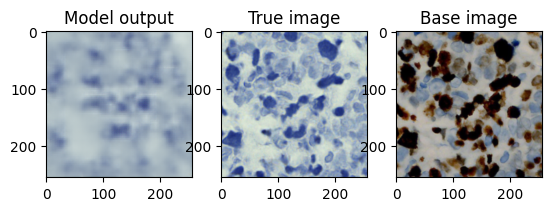

25it [00:28,  1.13s/it]


Epoch [122/200], Train Loss: 0.0051, Validation Loss: 0.0061


0it [00:00, ?it/s]

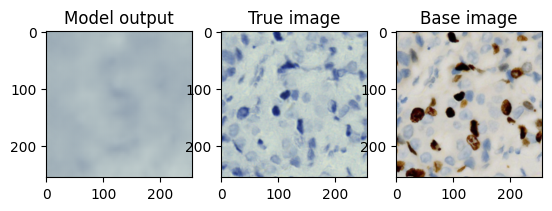

25it [00:29,  1.16s/it]


Epoch [123/200], Train Loss: 0.0052, Validation Loss: 0.0058


0it [00:00, ?it/s]

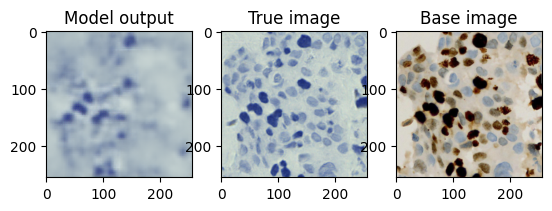

25it [00:27,  1.12s/it]


Epoch [124/200], Train Loss: 0.0050, Validation Loss: 0.0058


0it [00:00, ?it/s]

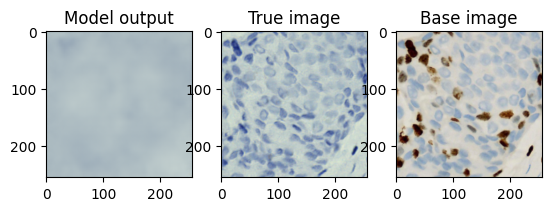

25it [00:28,  1.13s/it]


Epoch [125/200], Train Loss: 0.0050, Validation Loss: 0.0057


0it [00:00, ?it/s]

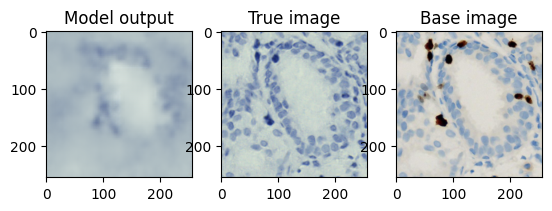

25it [00:28,  1.13s/it]


Epoch [126/200], Train Loss: 0.0049, Validation Loss: 0.0061


0it [00:00, ?it/s]

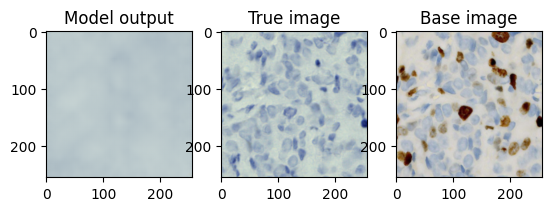

25it [00:28,  1.14s/it]


Epoch [127/200], Train Loss: 0.0052, Validation Loss: 0.0065


0it [00:00, ?it/s]

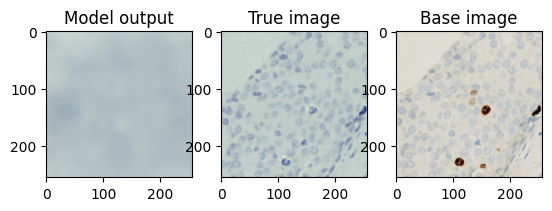

25it [00:27,  1.12s/it]


Epoch [128/200], Train Loss: 0.0048, Validation Loss: 0.0061


0it [00:00, ?it/s]

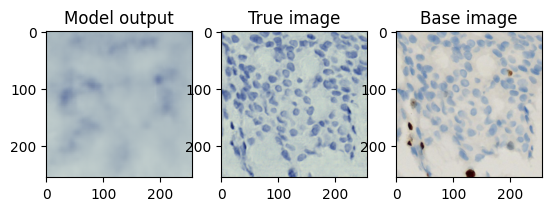

25it [00:28,  1.14s/it]


Epoch [129/200], Train Loss: 0.0048, Validation Loss: 0.0066


0it [00:00, ?it/s]

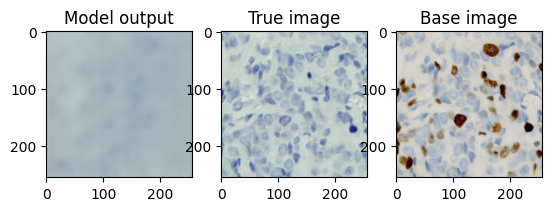

25it [00:28,  1.13s/it]


Epoch [130/200], Train Loss: 0.0050, Validation Loss: 0.0058


0it [00:00, ?it/s]

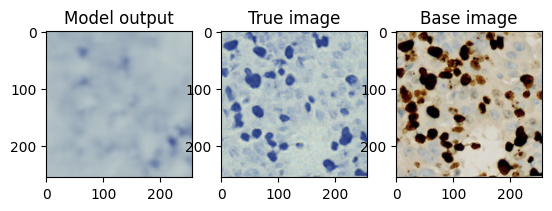

25it [00:28,  1.14s/it]


Epoch [131/200], Train Loss: 0.0046, Validation Loss: 0.0061


0it [00:00, ?it/s]

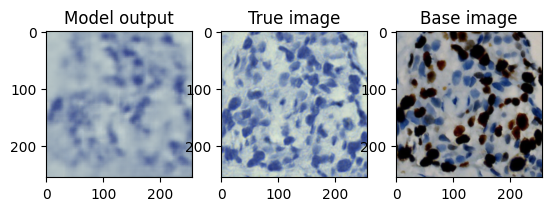

25it [00:28,  1.14s/it]


Epoch [132/200], Train Loss: 0.0046, Validation Loss: 0.0058


0it [00:00, ?it/s]

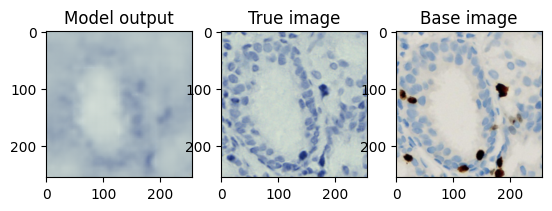

25it [00:28,  1.15s/it]


Epoch [133/200], Train Loss: 0.0046, Validation Loss: 0.0058


0it [00:00, ?it/s]

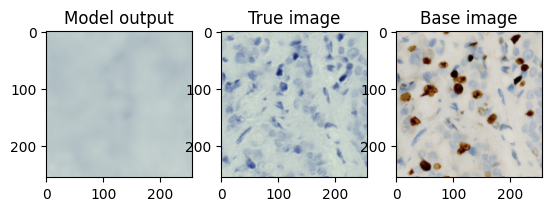

25it [00:28,  1.14s/it]


Epoch [134/200], Train Loss: 0.0046, Validation Loss: 0.0061


0it [00:00, ?it/s]

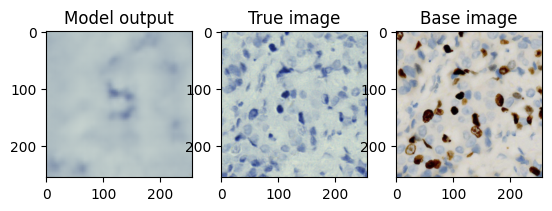

25it [00:29,  1.19s/it]


Epoch [135/200], Train Loss: 0.0046, Validation Loss: 0.0059


0it [00:00, ?it/s]

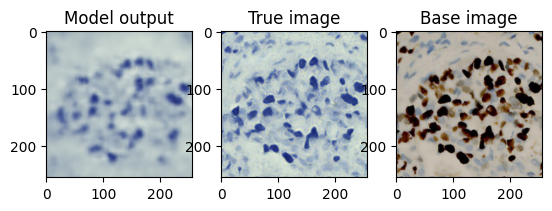

25it [00:28,  1.13s/it]


Epoch [136/200], Train Loss: 0.0046, Validation Loss: 0.0064


0it [00:00, ?it/s]

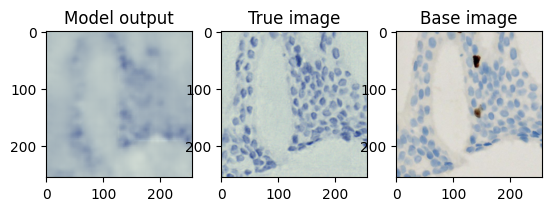

25it [00:30,  1.21s/it]


Epoch [137/200], Train Loss: 0.0044, Validation Loss: 0.0059


0it [00:00, ?it/s]

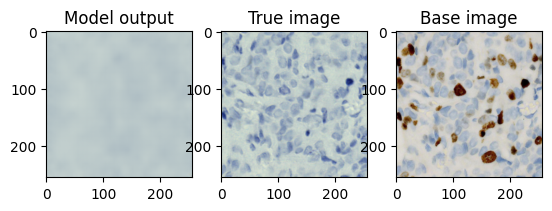

25it [00:29,  1.16s/it]


Epoch [138/200], Train Loss: 0.0045, Validation Loss: 0.0059


0it [00:00, ?it/s]

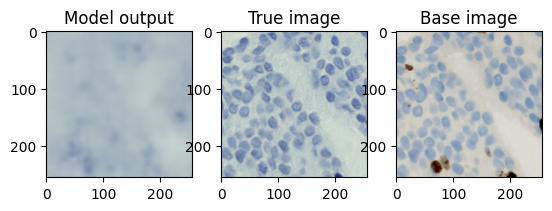

25it [00:27,  1.11s/it]


Epoch [139/200], Train Loss: 0.0047, Validation Loss: 0.0062


0it [00:00, ?it/s]

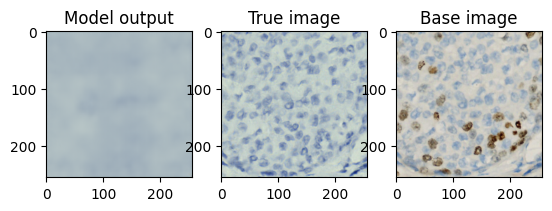

25it [00:27,  1.10s/it]


Epoch [140/200], Train Loss: 0.0044, Validation Loss: 0.0059


0it [00:00, ?it/s]

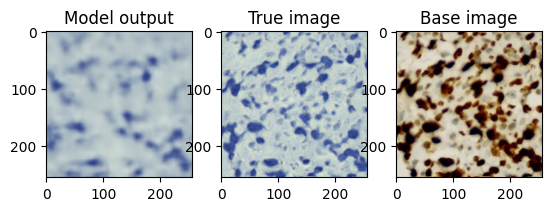

25it [00:28,  1.12s/it]


Epoch [141/200], Train Loss: 0.0043, Validation Loss: 0.0064


0it [00:00, ?it/s]

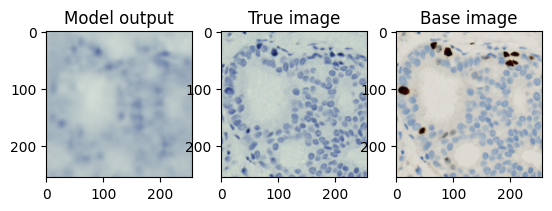

25it [00:28,  1.15s/it]


Epoch [142/200], Train Loss: 0.0043, Validation Loss: 0.0058


0it [00:00, ?it/s]

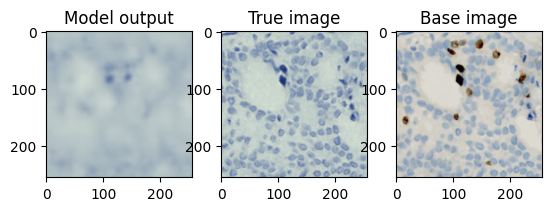

25it [00:28,  1.15s/it]


Epoch [143/200], Train Loss: 0.0041, Validation Loss: 0.0062


0it [00:00, ?it/s]

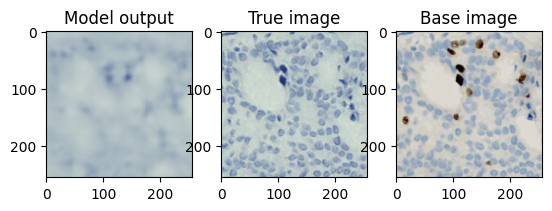

25it [00:27,  1.12s/it]


Epoch [144/200], Train Loss: 0.0040, Validation Loss: 0.0064


0it [00:00, ?it/s]

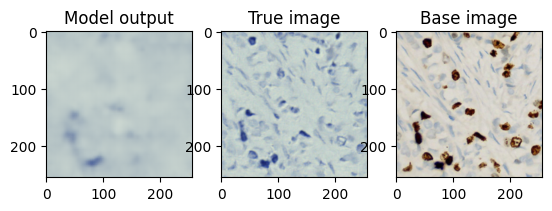

25it [00:28,  1.13s/it]


Epoch [145/200], Train Loss: 0.0040, Validation Loss: 0.0061


0it [00:00, ?it/s]

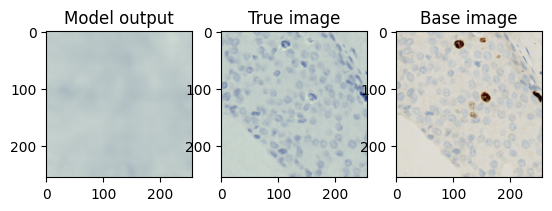

25it [00:28,  1.13s/it]


Epoch [146/200], Train Loss: 0.0041, Validation Loss: 0.0062


0it [00:00, ?it/s]

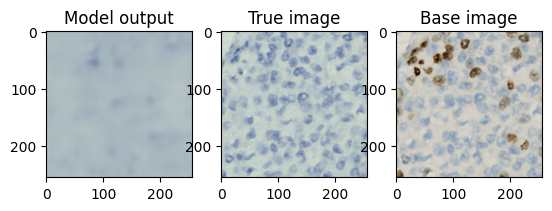

25it [00:28,  1.14s/it]


Epoch [147/200], Train Loss: 0.0039, Validation Loss: 0.0061


0it [00:00, ?it/s]

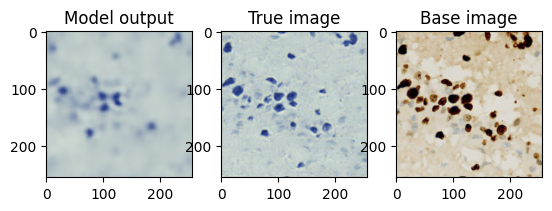

25it [00:28,  1.14s/it]


Epoch [148/200], Train Loss: 0.0040, Validation Loss: 0.0066


0it [00:00, ?it/s]

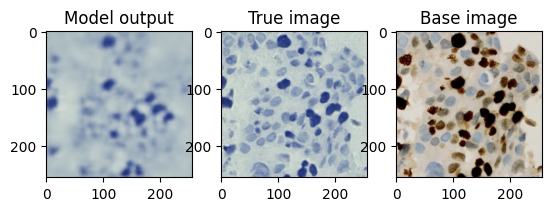

25it [00:28,  1.12s/it]


Epoch [149/200], Train Loss: 0.0038, Validation Loss: 0.0063


0it [00:00, ?it/s]

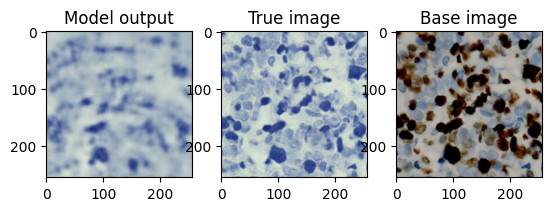

25it [00:28,  1.14s/it]


Epoch [150/200], Train Loss: 0.0037, Validation Loss: 0.0061


0it [00:00, ?it/s]

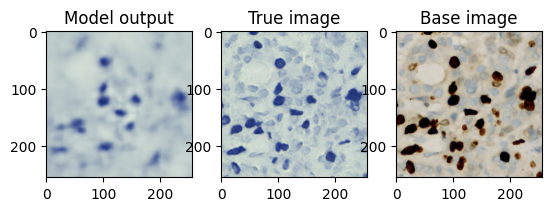

25it [00:28,  1.14s/it]


Epoch [151/200], Train Loss: 0.0039, Validation Loss: 0.0065


0it [00:00, ?it/s]

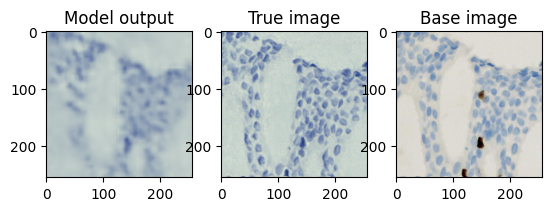

25it [00:28,  1.14s/it]


Epoch [152/200], Train Loss: 0.0037, Validation Loss: 0.0063


0it [00:00, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


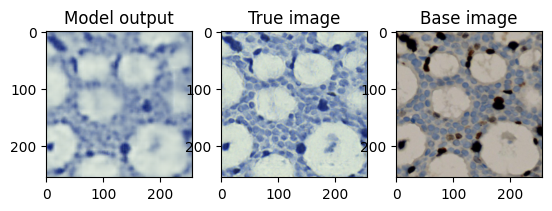

25it [00:28,  1.12s/it]


Epoch [153/200], Train Loss: 0.0038, Validation Loss: 0.0065


0it [00:00, ?it/s]

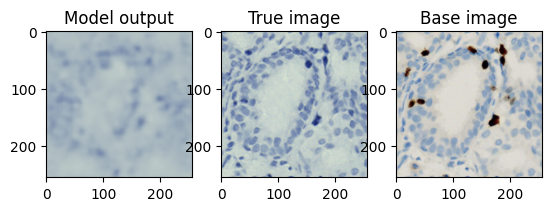

25it [00:28,  1.15s/it]


Epoch [154/200], Train Loss: 0.0039, Validation Loss: 0.0066


0it [00:00, ?it/s]

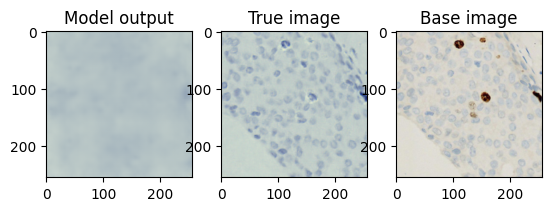

25it [00:28,  1.15s/it]


Epoch [155/200], Train Loss: 0.0037, Validation Loss: 0.0064


0it [00:00, ?it/s]

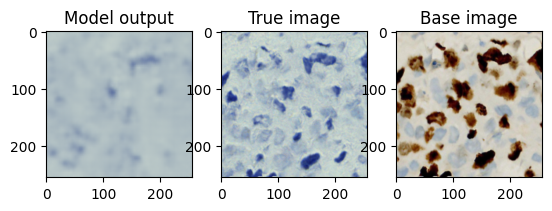

25it [00:28,  1.15s/it]


Epoch [156/200], Train Loss: 0.0035, Validation Loss: 0.0061


0it [00:00, ?it/s]

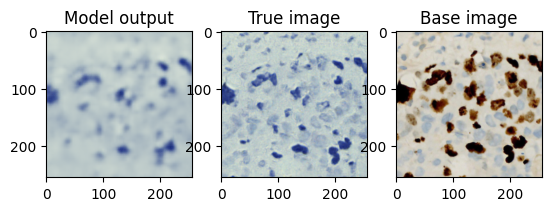

25it [00:28,  1.14s/it]


Epoch [157/200], Train Loss: 0.0033, Validation Loss: 0.0061


0it [00:00, ?it/s]

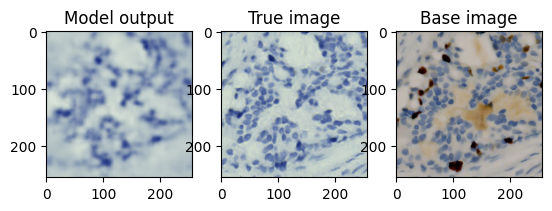

25it [00:27,  1.12s/it]


Epoch [158/200], Train Loss: 0.0034, Validation Loss: 0.0062


0it [00:00, ?it/s]

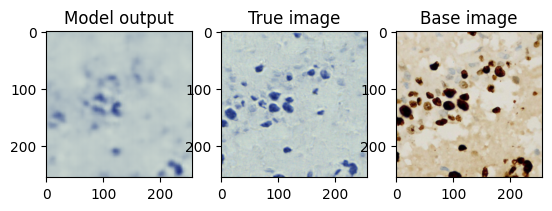

25it [00:28,  1.14s/it]


Epoch [159/200], Train Loss: 0.0034, Validation Loss: 0.0064


0it [00:00, ?it/s]

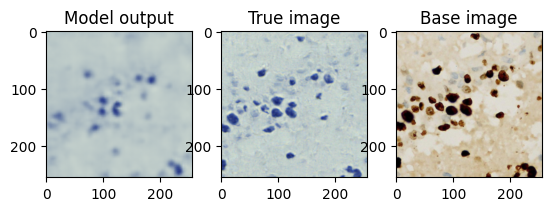

25it [00:28,  1.15s/it]


Epoch [160/200], Train Loss: 0.0034, Validation Loss: 0.0066


0it [00:00, ?it/s]

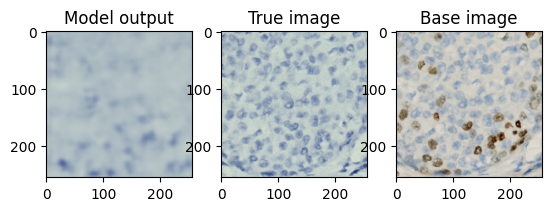

25it [00:29,  1.16s/it]


Epoch [161/200], Train Loss: 0.0034, Validation Loss: 0.0062


0it [00:00, ?it/s]

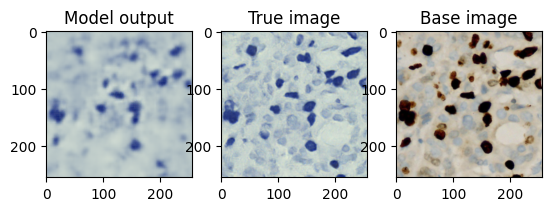

25it [00:28,  1.15s/it]


Epoch [162/200], Train Loss: 0.0032, Validation Loss: 0.0068


0it [00:00, ?it/s]

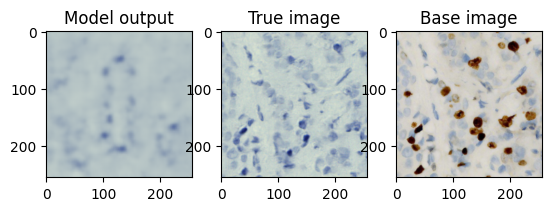

25it [00:28,  1.13s/it]


Epoch [163/200], Train Loss: 0.0031, Validation Loss: 0.0062


0it [00:00, ?it/s]

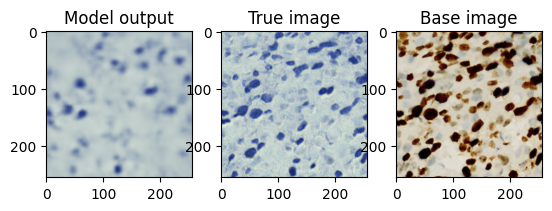

25it [00:28,  1.15s/it]


Epoch [164/200], Train Loss: 0.0030, Validation Loss: 0.0061


0it [00:00, ?it/s]

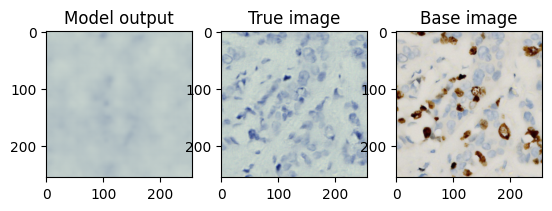

25it [00:28,  1.16s/it]


Epoch [165/200], Train Loss: 0.0031, Validation Loss: 0.0067


0it [00:00, ?it/s]

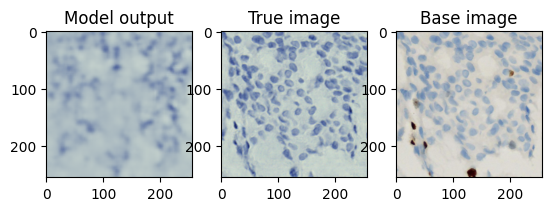

25it [00:28,  1.15s/it]


Epoch [166/200], Train Loss: 0.0030, Validation Loss: 0.0064


0it [00:00, ?it/s]

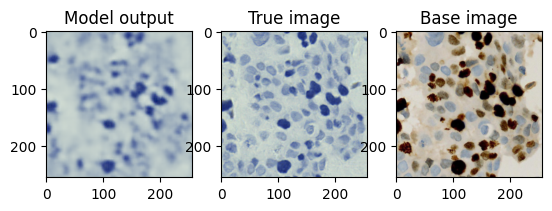

25it [00:28,  1.13s/it]


Epoch [167/200], Train Loss: 0.0029, Validation Loss: 0.0063


0it [00:00, ?it/s]

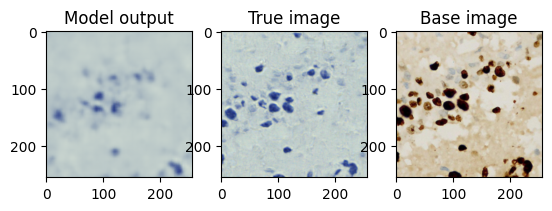

25it [00:28,  1.15s/it]


Epoch [168/200], Train Loss: 0.0028, Validation Loss: 0.0064


0it [00:00, ?it/s]

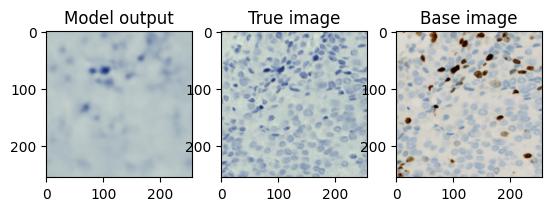

25it [00:28,  1.16s/it]


Epoch [169/200], Train Loss: 0.0030, Validation Loss: 0.0064


0it [00:00, ?it/s]

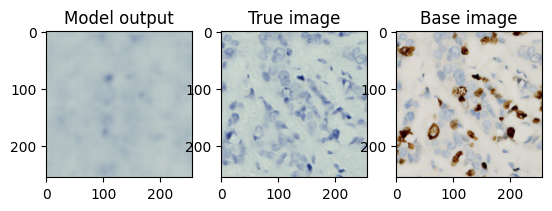

25it [00:28,  1.15s/it]


Epoch [170/200], Train Loss: 0.0029, Validation Loss: 0.0064


0it [00:00, ?it/s]

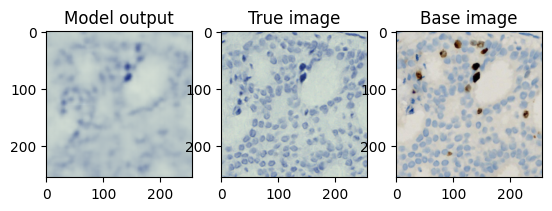

25it [00:29,  1.16s/it]


Epoch [171/200], Train Loss: 0.0032, Validation Loss: 0.0067


0it [00:00, ?it/s]

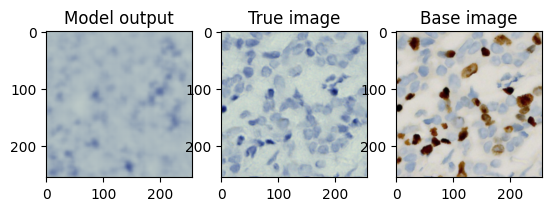

25it [00:28,  1.14s/it]


Epoch [172/200], Train Loss: 0.0029, Validation Loss: 0.0060


0it [00:00, ?it/s]

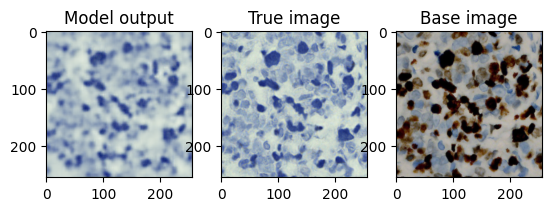

25it [00:28,  1.16s/it]


Epoch [173/200], Train Loss: 0.0028, Validation Loss: 0.0064


0it [00:00, ?it/s]

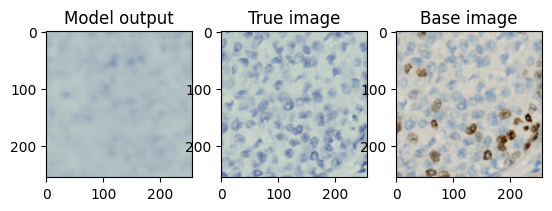

25it [00:28,  1.16s/it]


Epoch [174/200], Train Loss: 0.0029, Validation Loss: 0.0063


0it [00:00, ?it/s]

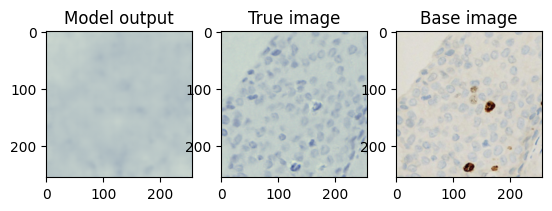

25it [00:28,  1.15s/it]


Epoch [175/200], Train Loss: 0.0026, Validation Loss: 0.0063


0it [00:00, ?it/s]

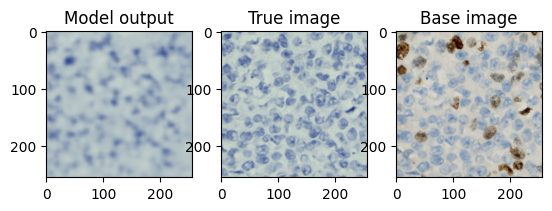

25it [00:28,  1.15s/it]


Epoch [176/200], Train Loss: 0.0027, Validation Loss: 0.0064


0it [00:00, ?it/s]

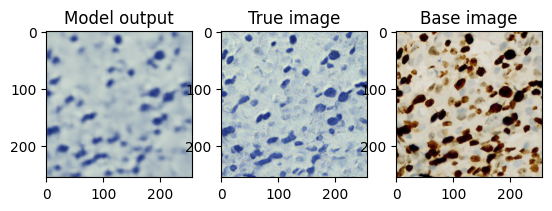

25it [00:28,  1.13s/it]


Epoch [177/200], Train Loss: 0.0028, Validation Loss: 0.0065


0it [00:00, ?it/s]

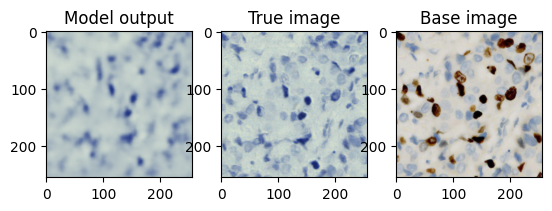

25it [00:28,  1.16s/it]


Epoch [178/200], Train Loss: 0.0027, Validation Loss: 0.0063


0it [00:00, ?it/s]

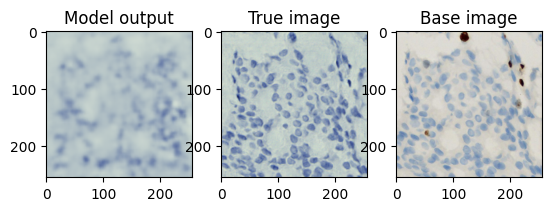

25it [00:29,  1.16s/it]


Epoch [179/200], Train Loss: 0.0028, Validation Loss: 0.0067


0it [00:00, ?it/s]

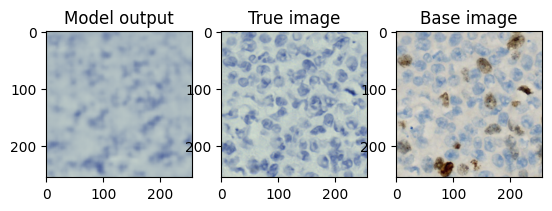

25it [00:29,  1.16s/it]


Epoch [180/200], Train Loss: 0.0027, Validation Loss: 0.0068


0it [00:00, ?it/s]

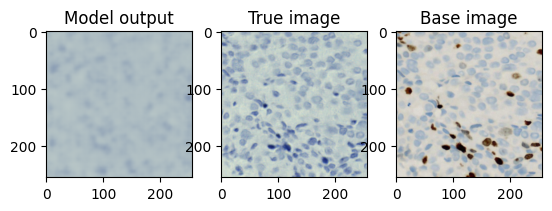

25it [00:28,  1.15s/it]


Epoch [181/200], Train Loss: 0.0026, Validation Loss: 0.0063


0it [00:00, ?it/s]

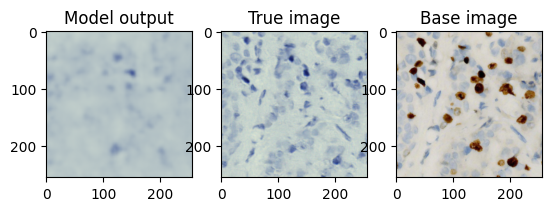

25it [00:28,  1.14s/it]


Epoch [182/200], Train Loss: 0.0024, Validation Loss: 0.0062


0it [00:00, ?it/s]

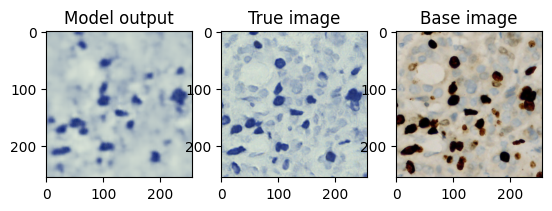

25it [00:29,  1.16s/it]


Epoch [183/200], Train Loss: 0.0026, Validation Loss: 0.0068


0it [00:00, ?it/s]

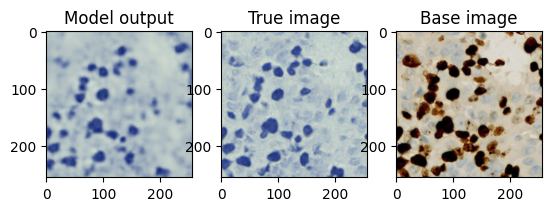

25it [00:28,  1.14s/it]


Epoch [184/200], Train Loss: 0.0024, Validation Loss: 0.0065


0it [00:00, ?it/s]

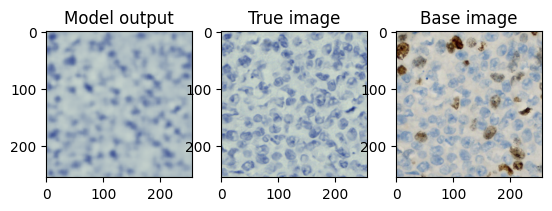

25it [00:29,  1.16s/it]


Epoch [185/200], Train Loss: 0.0024, Validation Loss: 0.0063


0it [00:00, ?it/s]

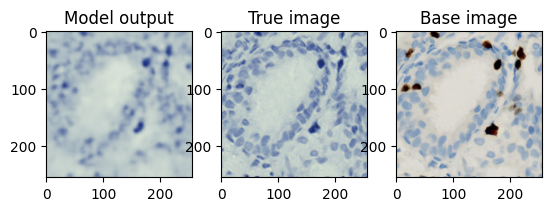

25it [00:29,  1.16s/it]


Epoch [186/200], Train Loss: 0.0025, Validation Loss: 0.0066


0it [00:00, ?it/s]

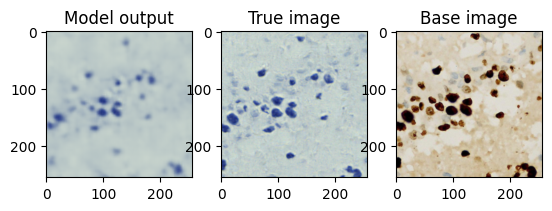

25it [00:28,  1.15s/it]


Epoch [187/200], Train Loss: 0.0022, Validation Loss: 0.0064


0it [00:00, ?it/s]

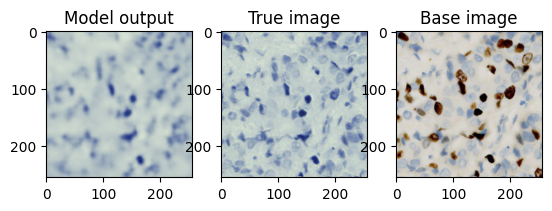

25it [00:28,  1.16s/it]


Epoch [188/200], Train Loss: 0.0022, Validation Loss: 0.0063


0it [00:00, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


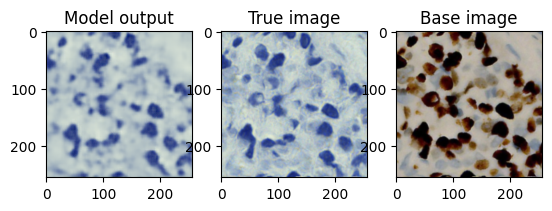

25it [00:29,  1.16s/it]


Epoch [189/200], Train Loss: 0.0026, Validation Loss: 0.0068


0it [00:00, ?it/s]

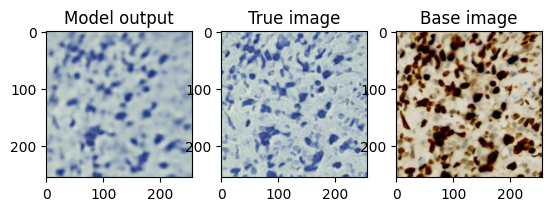

25it [00:29,  1.17s/it]


Epoch [190/200], Train Loss: 0.0026, Validation Loss: 0.0068


0it [00:00, ?it/s]

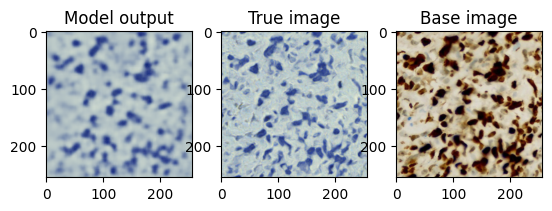

25it [00:28,  1.15s/it]


Epoch [191/200], Train Loss: 0.0023, Validation Loss: 0.0065


0it [00:00, ?it/s]

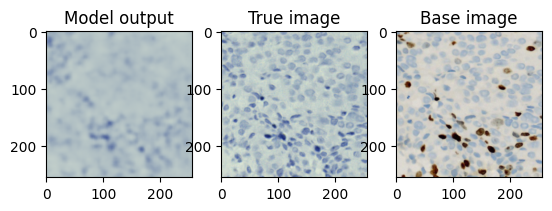

25it [00:28,  1.16s/it]


Epoch [192/200], Train Loss: 0.0022, Validation Loss: 0.0065


0it [00:00, ?it/s]

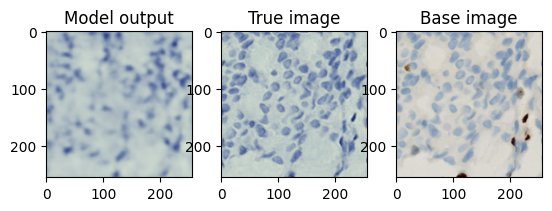

25it [00:29,  1.17s/it]


Epoch [193/200], Train Loss: 0.0025, Validation Loss: 0.0071


0it [00:00, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


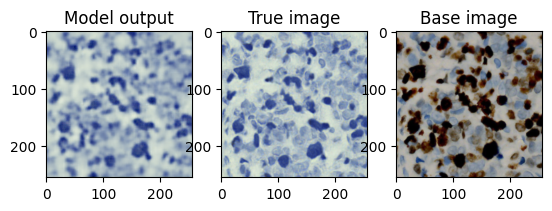

25it [00:29,  1.17s/it]


Epoch [194/200], Train Loss: 0.0025, Validation Loss: 0.0066


0it [00:00, ?it/s]

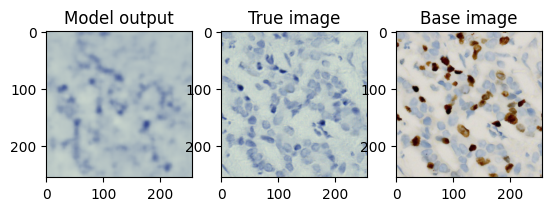

25it [00:29,  1.18s/it]


Epoch [195/200], Train Loss: 0.0024, Validation Loss: 0.0068


0it [00:00, ?it/s]

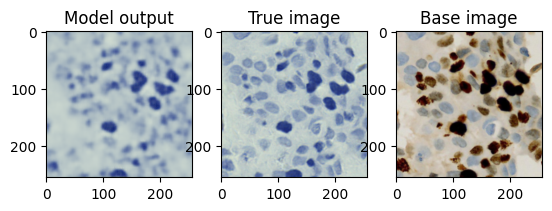

25it [00:28,  1.15s/it]


Epoch [196/200], Train Loss: 0.0022, Validation Loss: 0.0066


0it [00:00, ?it/s]

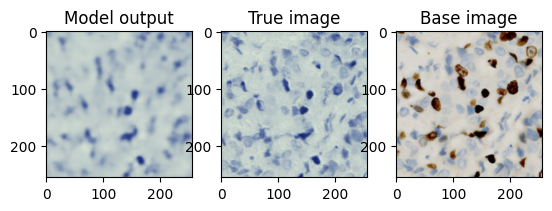

25it [00:29,  1.18s/it]


Epoch [197/200], Train Loss: 0.0021, Validation Loss: 0.0065


0it [00:00, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


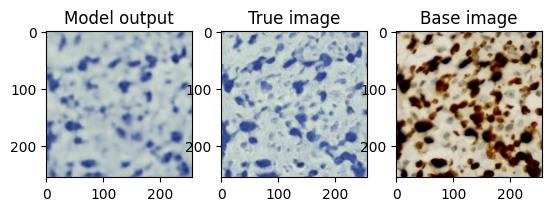

25it [00:29,  1.17s/it]


Epoch [198/200], Train Loss: 0.0024, Validation Loss: 0.0074


0it [00:00, ?it/s]

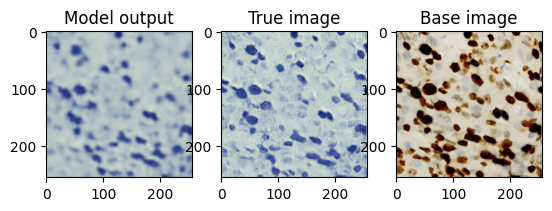

25it [00:29,  1.16s/it]


Epoch [199/200], Train Loss: 0.0023, Validation Loss: 0.0064


0it [00:00, ?it/s]

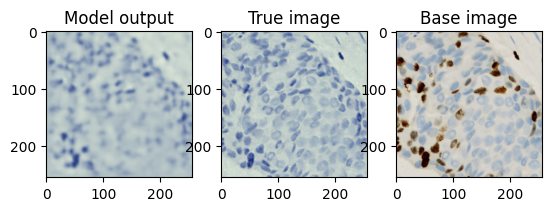

25it [00:29,  1.16s/it]


Epoch [200/200], Train Loss: 0.0020, Validation Loss: 0.0065


In [ ]:
num_epochs = 200

best_val_loss = float('inf')
for epoch in range(num_epochs):
    train_loss = train(model, train_loader, criterion, optimizer, device)
    val_loss = validate(model, val_loader, criterion, device)
    all_train_loss.append(train_loss)
    all_val_loss.append(val_loss)

    print(f'Epoch [{epoch+1}/{num_epochs}], Train Loss: {train_loss:.4f}, Validation Loss: {val_loss:.4f}')

    # Save best model
    if val_loss < best_val_loss:
        best_val_loss = val_loss
        torch.save(model.state_dict(), save_dir+'/best_model.pth')

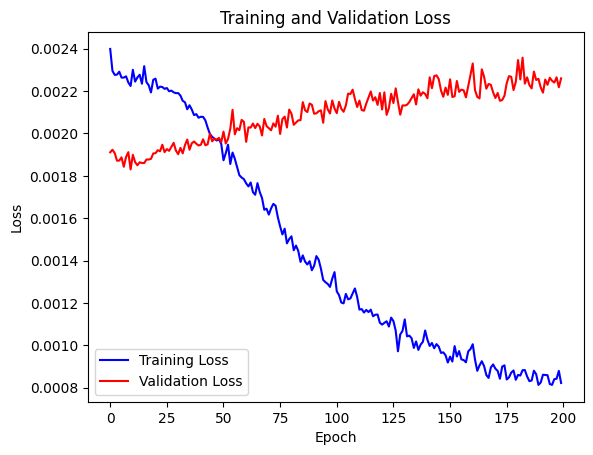

In [ ]:
plt.plot(all_train_loss, 'b', label='Training Loss')
plt.plot(all_val_loss, 'r', label='Validation Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()

In [ ]:
# Load the saved model
best_model = Autoencoder()
best_model.load_state_dict(torch.load(save_dir+'/best_model.pth'))


# Set the model to evaluation mode
best_model.eval()

# Initialize variables for tracking loss and accuracy
total_loss = 0.0


# Iterate through the test set
for inputs, targets in tqdm(test_loader):
    # Pass the inputs through the model to get the predictions
    outputs = best_model(inputs)
    
    # Calculate the loss
    loss = criterion(outputs, targets)
    total_loss += loss.item()
    
# Calculate the average loss and accuracy
avg_loss = total_loss / len(test_loader)

# Print the results
print('Average loss: {:.4f}'.format(avg_loss))



100%|██████████| 38/38 [06:00<00:00,  9.49s/it]

Average loss: 0.0017


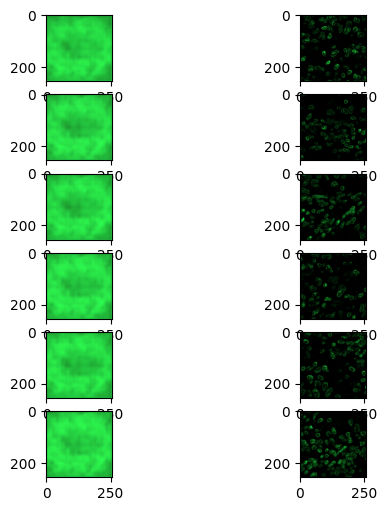

In [ ]:
# Plot the predicted images and test images side by side
fig, axs = plt.subplots(6, 2, figsize=(6, 6))

for i in range(6):
    axs[i, 0].imshow(np.transpose(torchvision.utils.make_grid(outputs[i], normalize=True).cpu().numpy(), (1, 2, 0)))
    axs[i, 1].imshow(np.transpose(torchvision.utils.make_grid(targets[i], normalize=True).cpu().numpy(), (1, 2, 0)))

plt.show()

# 2. Segmentation approach with UNet and Masking

In [ ]:
!pip install segmentation-models-pytorch

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 106.7/106.7 kB 6.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 7.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 549.1/549.1 kB 40.5 MB/s eta 0:00:00
  Created wheel for efficientnet-pytorch: filename=efficientnet_pytorch-0.7.1-py3-none-any.whl size=16444 sha256=8dfca11196efd648092e4f0ad8aa0fbe9ca9f8f34d8056c5c4e60c1257ebb24d
  Stored in directory: /root/.cache/pip/wheels/03/3f/e9/911b1bc46869644912bda90a56bcf7b960f20b5187feea3baf
  Created wheel for pretrainedmodels: filename=pretrainedmodels-0.7.4-py3-none-any.whl size=60962 sha256=e54693102f609f37d92e5fdbaeae1da88c9790e35fe9d69c60379233b5ee9667
  Stored in directory: /root/.cache/pip/wheels/35/cb/a5/8f534c60142835bfc889f9a482e4a67e0b817032d9c6883b64
Successfully bu

In [ ]:
class SegmentationDataset(Dataset):
    def __init__(self, root_dir, transform=None):
        self.root_dir = root_dir
        self.transform = transform
        self.image_filenames = os.listdir(root_dir)

    def __len__(self):
        return len(self.image_filenames)

    def __getitem__(self, index):
        # Load the concatenated image
        image_filename = self.image_filenames[index]
        image_path = os.path.join(self.root_dir, image_filename)
        image = Image.open(image_path).convert('RGB')
        size = 512

        # Split the image into x and y's
        x = image.crop((0, 0, size, size))
        y1 = image.crop((size, 0, size*2, size))
        y2 = image.crop((size*2, 0, size*3, size))
        y3 = image.crop((size*3, 0, size*4, size))
        y4 = image.crop((size*4, 0, size*5, size))
        y5 = image.crop((size*5, 0, size*6, size))

        # Convert the mask to binary and resize to 256x256
        y = y5
        #y = y.convert('L')

        #threshold = 128
        #y3 = y3.point(lambda p: p > threshold and 255)
        #y3 = y3.convert('1')
        #y3 = y3.resize((256, 256))

        # Apply transformations to x and y's if provided
        if self.transform:
            x = self.transform(x)
            y = self.transform(y)

        # Return x and ys as a tuple
        return x, y


# Define transformations to apply to the images
transform = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.ToTensor(),
    #transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
])

batch_size = 16
# Create the datasets and dataloaders
train_dataset = SegmentationDataset(train_dir, transform=transform)
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)

val_dataset = SegmentationDataset(val_dir, transform=transform)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

test_dataset = SegmentationDataset(test_dir, transform=transform)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)



In [ ]:
# define a function to plot images
def plot_images(model_output, base_image, true_image):
    fig, axs = plt.subplots(1, 3)
    #model_output = model_output.convert('RGB')
    #base_image = base_image.convert('RGB')
    #true_image = true_image.convert('RGB')
    axs[0].imshow(model_output.permute(1, 2, 0).cpu().detach().numpy())
    axs[0].set_title('Model output')
    axs[1].imshow(true_image.permute(1, 2, 0).cpu().detach().numpy())
    axs[1].set_title('True image')
    axs[2].imshow(base_image.permute(1, 2, 0).cpu().detach().numpy())
    axs[2].set_title('Base image')
    plt.show()

Text(0.5, 1.0, 'Base image')

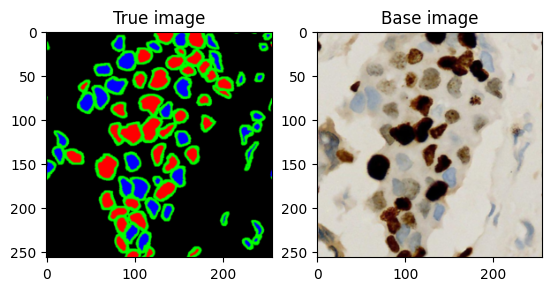

In [ ]:
# get one random sample from the dataloader
x, y = next(iter(train_loader))
true_image = y[0]
base_image = x[0]
fig, axs = plt.subplots(1, 2)
axs[0].imshow(true_image.permute(1, 2, 0).cpu().detach().numpy())
axs[0].set_title('True image')
axs[1].imshow(base_image.permute(1, 2, 0).cpu().detach().numpy())
axs[1].set_title('Base image')



In [ ]:
import segmentation_models_pytorch as smp

# Define the model
model = smp.Unet(
    encoder_name="resnet50",        # Use the ResNet-50 encoder
    encoder_weights="imagenet",     # Use the pre-trained weights from ImageNet
    classes=3,                      # The number of classes to predict 
)
# model2 = smp.Unet(
#     encoder_name="resnet50",        # Use the ResNet-50 encoder
#     encoder_weights="imagenet",     # Use the pre-trained weights from ImageNet
#     classes=3,                      # The number of classes to predict 
# )
# model3 = smp.Unet(
#     encoder_name="resnet50",        # Use the ResNet-50 encoder
#     encoder_weights="imagenet",     # Use the pre-trained weights from ImageNet
#     classes=3,                      # The number of classes to predict 
# )
# model4 = smp.Unet(
#     encoder_name="resnet50",        # Use the ResNet-50 encoder
#     encoder_weights="imagenet",     # Use the pre-trained weights from ImageNet
#     classes=3,                      # The number of classes to predict 
# )
# model5 = smp.Unet(
#     encoder_name="resnet50",        # Use the ResNet-50 encoder
#     encoder_weights="imagenet",     # Use the pre-trained weights from ImageNet
#     classes=3,                      # The number of classes to predict 
# )

# Define the loss function 
criterion = smp.losses.DiceLoss(mode='multilabel')


Downloading: "https://download.pytorch.org/models/resnet50-19c8e357.pth" to /root/.cache/torch/hub/checkpoints/resnet50-19c8e357.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 148MB/s]


In [ ]:
# define variables to keep track of the best model and best validation loss
best_model_unet = None
#best_model_unet2 = None
#best_model_unet3 = None
#best_model_unet4 = None
#best_model_unet5 = None


best_val_loss = float('inf')
#best_val_loss2 = float('inf')
#best_val_loss3 = float('inf')
#best_val_loss4 = float('inf')
#best_val_loss5 = float('inf')

model.to(device)
#model2.to(device)
#model3.to(device)
#model4.to(device)
#model5.to(device)
criterion.to(device)

# Train and validate loop
all_train_loss, all_val_loss = [], []

In [ ]:
# Training loop

# create the models directory if it doesn't exist
save_dir = '/content/drive/MyDrive/Columbia/Deepliif/models/deeplite'


def train(model, train_loader, criterion, optimizer, device):
    model.train()
    #model2.train()
    #model3.train()
    #model4.train()
    #model5.train()

    train_loss = 0

    for i, (x, y1) in tqdm(enumerate(train_loader)):
        x = x.to(device)
        y1 = y1.to(device)
        #y2 = y2.to(device)
        #y3 = y3.to(device)
        #y4 = y4.to(device)
        #y5 = y5.to(device)

        # Forward pass
        y1_pred = model(x)
        #y2_pred = model2(x)
        #y3_pred = model3(x)
        #y4_pred = model4(x)
        #y5_pred = model5(x)

        loss1 = criterion(y1_pred, y1)
        #loss2 = criterion(y2_pred, y2)
        #loss3 = criterion(y3_pred, y3)
        #loss4 = criterion(y4_pred, y4)
        #loss5 = criterion(y5_pred, y5)
        
        loss = loss1 

        if i==0:
          plot_images(y1_pred[0,:,:,:],
                        x[0,:,:,:], y1[0,:,:,:])

        # Backward pass and optimization
        optimizer.zero_grad()
        loss.backward()
        #loss2.backward()
        #loss3.backward()
        #loss4.backward()
        #loss5.backward()

        optimizer.step()

        train_loss += loss.item()

    return train_loss / len(train_loader)

def validate(model, val_loader, criterion, device):
    model.eval()
    #model2.eval()
    #model3.eval()
    #model4.eval()
    #model5.eval()

    val_loss = 0

    with torch.no_grad():
        for i, (x, y1) in enumerate(val_loader):
            x = x.to(device)
            y1 = y1.to(device)
            #y2 = y2.to(device)
            #y3 = y3.to(device)
            #y4 = y4.to(device)
            #y5 = y5.to(device)

            # Forward pass
            y1_pred = model(x)
            #y2_pred = model2(x)
            #y3_pred = model3(x)
            #y4_pred = model4(x)
            #y5_pred = model5(x)

            loss1 = criterion(y1_pred, y1)
            #loss2 = criterion(y2_pred, y2)
            #loss3 = criterion(y3_pred, y3)
            #loss4 = criterion(y4_pred, y4)
            #loss5 = criterion(y5_pred, y5)
            loss = loss1 


            val_loss += loss1.item()
            #val_loss2 += loss2.item()
            #val_loss3 += loss3.item()
            #val_loss4 += loss4.item()
            #val_loss5 += loss5.item()

    

    return val_loss / len(val_loader) #, val_loss1 / len(val_loader), val_loss2 / len(val_loader), val_loss3 / len(val_loader), val_loss4 / len(val_loader), val_loss5 / len(val_loader),


0it [00:00, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


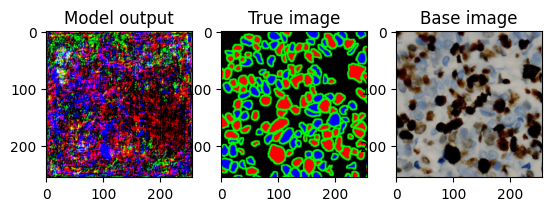

25it [00:40,  1.64s/it]


Epoch [1/50], Train Loss: 0.7267, Validation Loss: 0.7739


0it [00:00, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


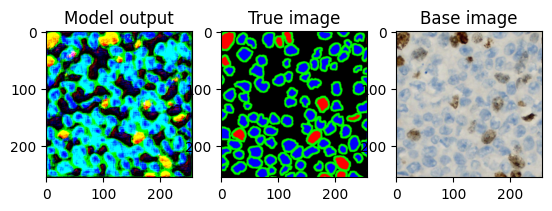

25it [00:33,  1.35s/it]


Epoch [2/50], Train Loss: 0.6607, Validation Loss: 0.6890


0it [00:00, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


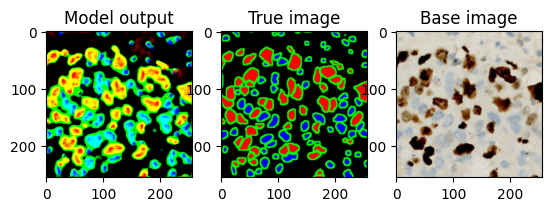

25it [00:31,  1.27s/it]


Epoch [3/50], Train Loss: 0.6150, Validation Loss: 0.6487


0it [00:00, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


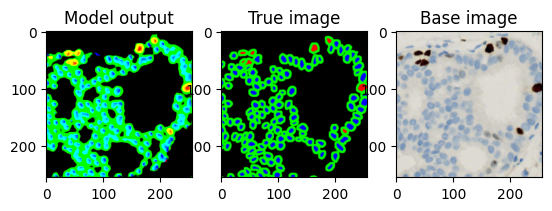

25it [00:31,  1.28s/it]


Epoch [4/50], Train Loss: 0.5691, Validation Loss: 0.6033


0it [00:00, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


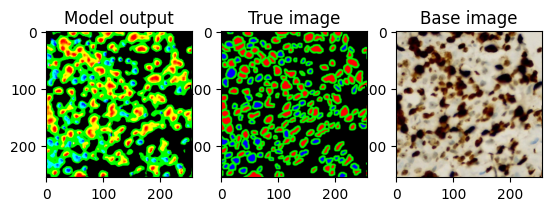

25it [00:32,  1.29s/it]


Epoch [5/50], Train Loss: 0.5194, Validation Loss: 0.5608


0it [00:00, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


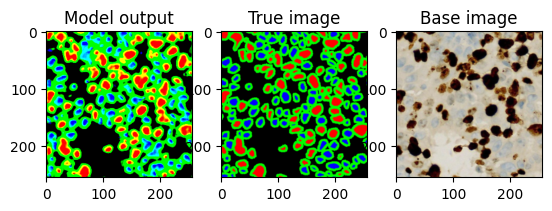

25it [00:36,  1.47s/it]


Epoch [6/50], Train Loss: 0.4706, Validation Loss: 0.5142


0it [00:00, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


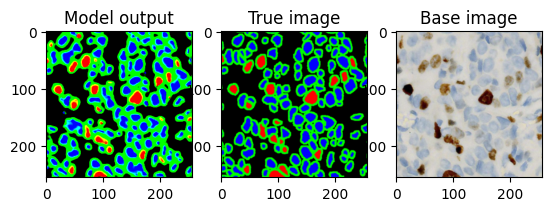

25it [00:33,  1.33s/it]


Epoch [7/50], Train Loss: 0.4185, Validation Loss: 0.4814


0it [00:00, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


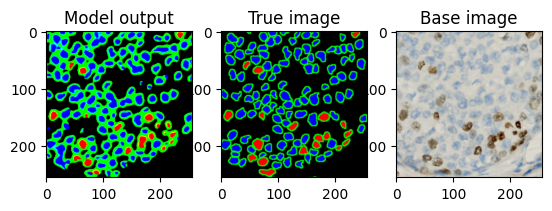

25it [00:32,  1.30s/it]


Epoch [8/50], Train Loss: 0.3760, Validation Loss: 0.4343


0it [00:00, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


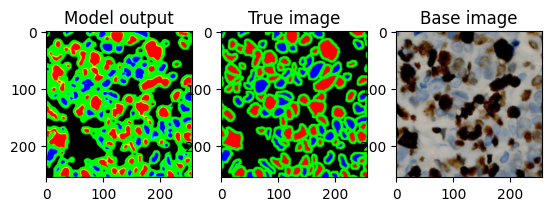

25it [00:34,  1.37s/it]


Epoch [9/50], Train Loss: 0.3381, Validation Loss: 0.4116


0it [00:00, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


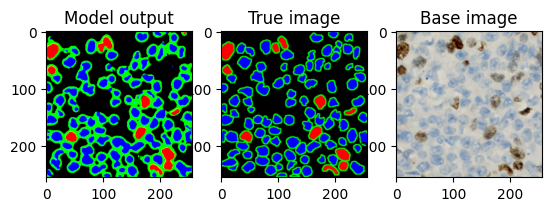

25it [00:32,  1.31s/it]


Epoch [10/50], Train Loss: 0.3127, Validation Loss: 0.3820


0it [00:00, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


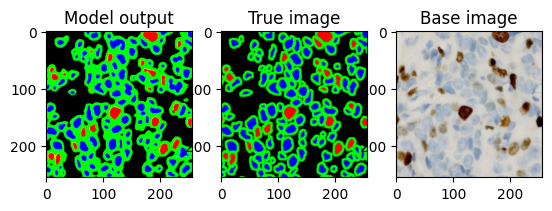

25it [00:32,  1.32s/it]


Epoch [11/50], Train Loss: 0.3016, Validation Loss: 0.3785


0it [00:00, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


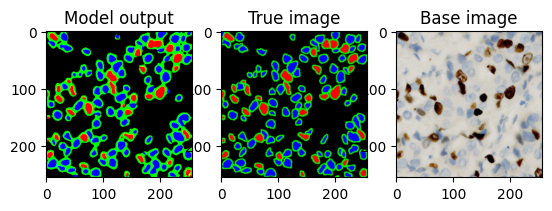

25it [00:32,  1.31s/it]


Epoch [12/50], Train Loss: 0.2799, Validation Loss: 0.3699


0it [00:00, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


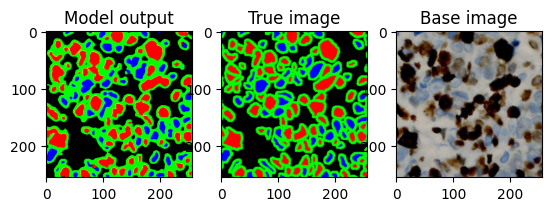

25it [00:31,  1.27s/it]


Epoch [13/50], Train Loss: 0.2678, Validation Loss: 0.4108


0it [00:00, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


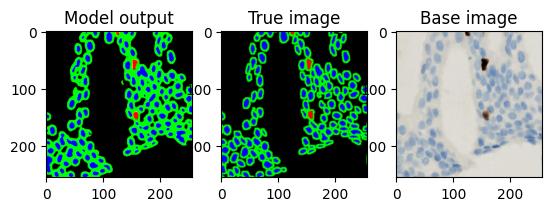

25it [00:31,  1.27s/it]


Epoch [14/50], Train Loss: 0.2534, Validation Loss: 0.3589


0it [00:00, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


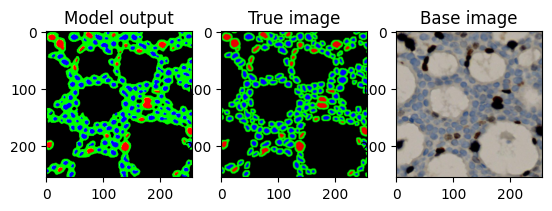

25it [00:32,  1.29s/it]


Epoch [15/50], Train Loss: 0.2412, Validation Loss: 0.3486


0it [00:00, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


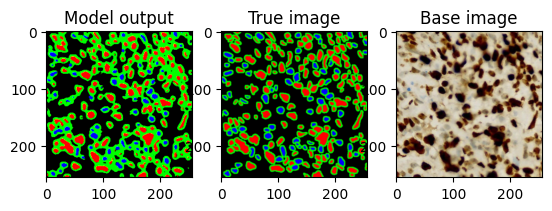

25it [00:33,  1.33s/it]


Epoch [16/50], Train Loss: 0.2371, Validation Loss: 0.3450


0it [00:00, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


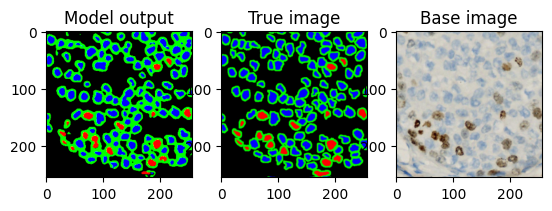

25it [00:32,  1.28s/it]


Epoch [17/50], Train Loss: 0.2332, Validation Loss: 0.3742


0it [00:00, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


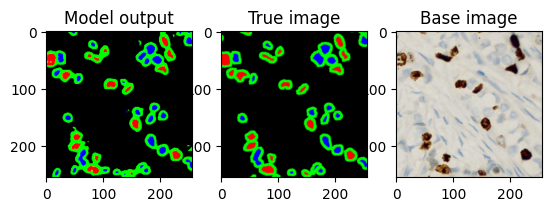

25it [00:32,  1.31s/it]


Epoch [18/50], Train Loss: 0.2282, Validation Loss: 0.3292


0it [00:00, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


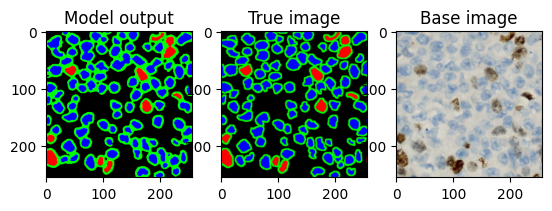

25it [00:32,  1.31s/it]


Epoch [19/50], Train Loss: 0.2215, Validation Loss: 0.4071


0it [00:00, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


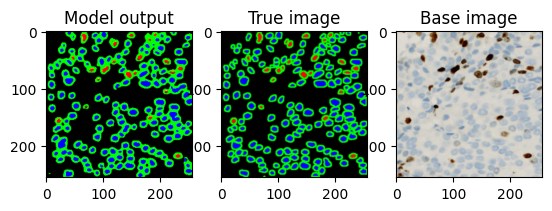

25it [00:32,  1.30s/it]


Epoch [20/50], Train Loss: 0.2161, Validation Loss: 0.3165


0it [00:00, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


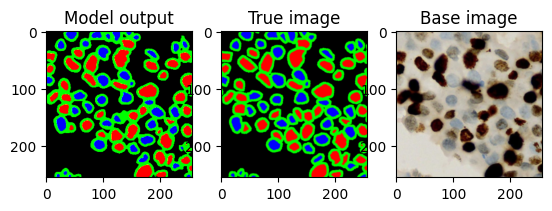

25it [00:32,  1.31s/it]


Epoch [21/50], Train Loss: 0.2117, Validation Loss: 0.3165


0it [00:00, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


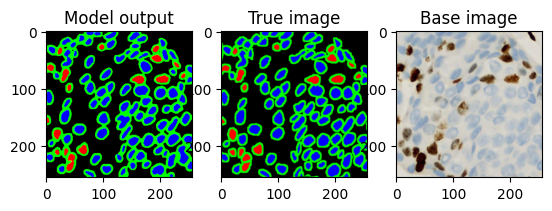

25it [00:31,  1.28s/it]


Epoch [22/50], Train Loss: 0.2143, Validation Loss: 0.3269


0it [00:00, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


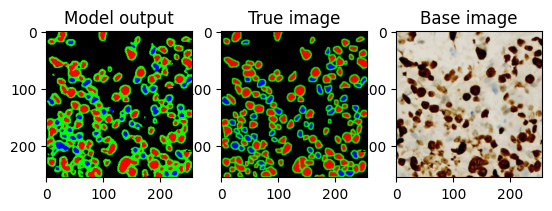

25it [00:32,  1.28s/it]


Epoch [23/50], Train Loss: 0.2069, Validation Loss: 0.3243


0it [00:00, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


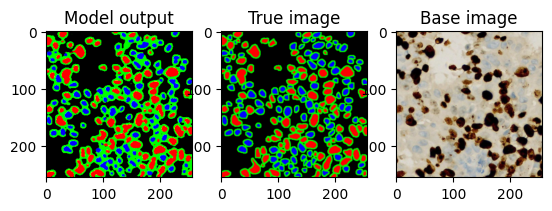

25it [00:31,  1.28s/it]


Epoch [24/50], Train Loss: 0.2035, Validation Loss: 0.3164


0it [00:00, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


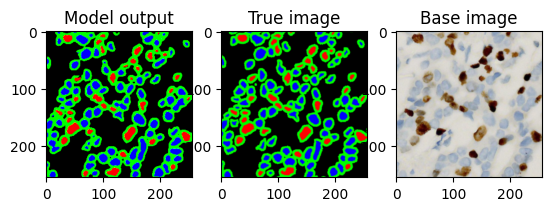

25it [00:33,  1.32s/it]


Epoch [25/50], Train Loss: 0.2090, Validation Loss: 0.3464


0it [00:00, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


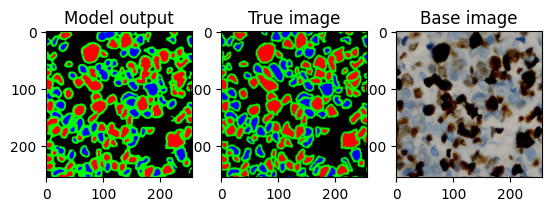

25it [00:32,  1.29s/it]


Epoch [26/50], Train Loss: 0.2075, Validation Loss: 0.3685


0it [00:00, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


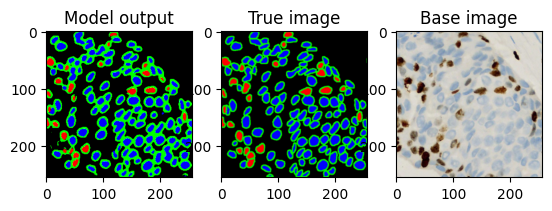

25it [00:32,  1.29s/it]


Epoch [27/50], Train Loss: 0.2056, Validation Loss: 0.3121


0it [00:00, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


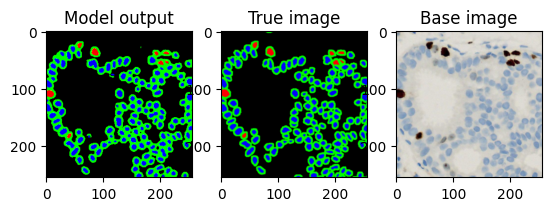

25it [00:32,  1.29s/it]


Epoch [28/50], Train Loss: 0.1968, Validation Loss: 0.3356


0it [00:00, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


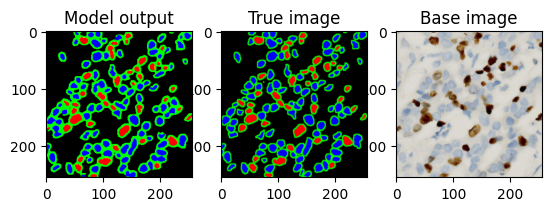

25it [00:31,  1.28s/it]


Epoch [29/50], Train Loss: 0.1884, Validation Loss: 0.3089


0it [00:00, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


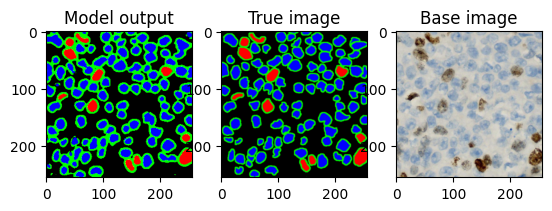

25it [00:33,  1.34s/it]


Epoch [30/50], Train Loss: 0.1892, Validation Loss: 0.3078


0it [00:00, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


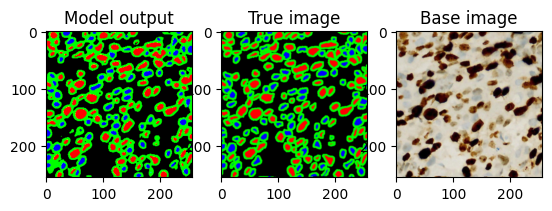

25it [00:32,  1.30s/it]


Epoch [31/50], Train Loss: 0.1851, Validation Loss: 0.3275


0it [00:00, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


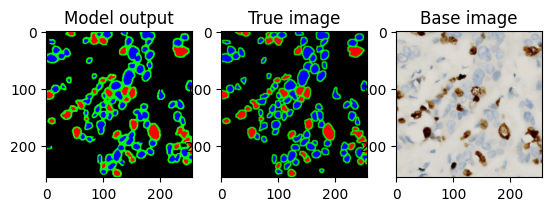

25it [00:32,  1.31s/it]


Epoch [32/50], Train Loss: 0.1897, Validation Loss: 0.3202


0it [00:00, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


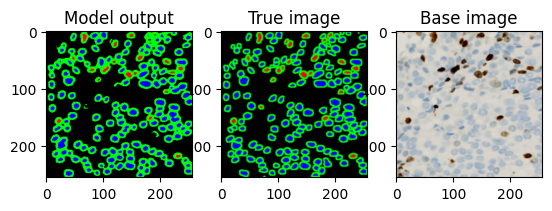

25it [00:32,  1.31s/it]


Epoch [33/50], Train Loss: 0.1793, Validation Loss: 0.3252


0it [00:00, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


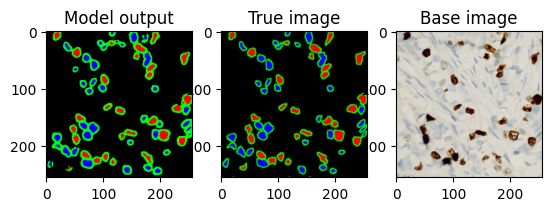

25it [00:32,  1.31s/it]


Epoch [34/50], Train Loss: 0.1813, Validation Loss: 0.3263


0it [00:00, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


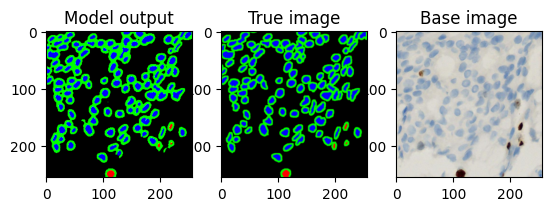

25it [00:32,  1.29s/it]


Epoch [35/50], Train Loss: 0.1835, Validation Loss: 0.3137


0it [00:00, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


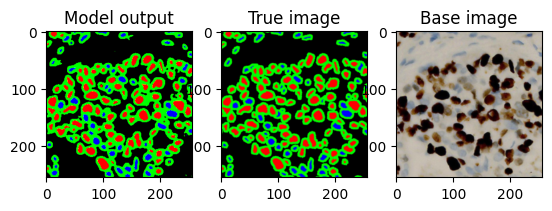

25it [00:32,  1.30s/it]


Epoch [36/50], Train Loss: 0.1733, Validation Loss: 0.3122


0it [00:00, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


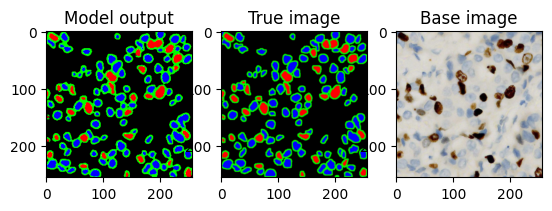

25it [00:32,  1.32s/it]


Epoch [37/50], Train Loss: 0.1701, Validation Loss: 0.2981


0it [00:00, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


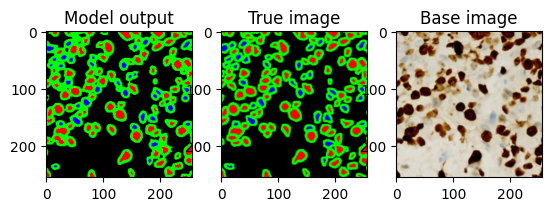

25it [00:32,  1.31s/it]


Epoch [38/50], Train Loss: 0.1693, Validation Loss: 0.3224


0it [00:00, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


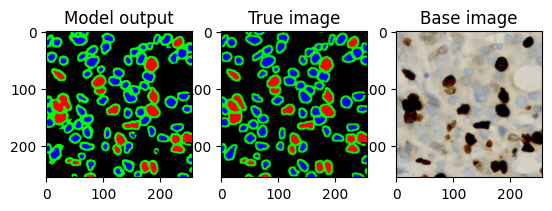

25it [00:32,  1.31s/it]


Epoch [39/50], Train Loss: 0.1711, Validation Loss: 0.3089


0it [00:00, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


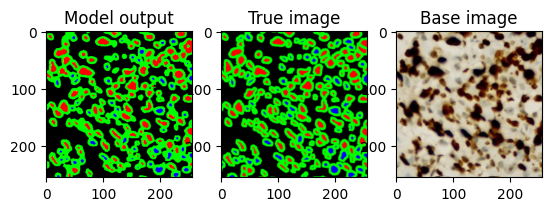

25it [00:32,  1.30s/it]


Epoch [40/50], Train Loss: 0.1717, Validation Loss: 0.3025


0it [00:00, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


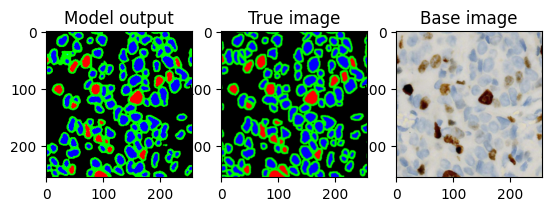

25it [00:32,  1.30s/it]


Epoch [41/50], Train Loss: 0.1631, Validation Loss: 0.3367


0it [00:00, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


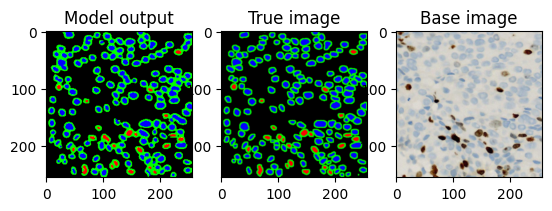

25it [00:32,  1.29s/it]


Epoch [42/50], Train Loss: 0.1616, Validation Loss: 0.3394


0it [00:00, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


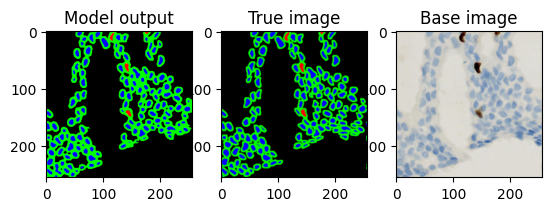

25it [00:32,  1.30s/it]


Epoch [43/50], Train Loss: 0.1641, Validation Loss: 0.3035


0it [00:00, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


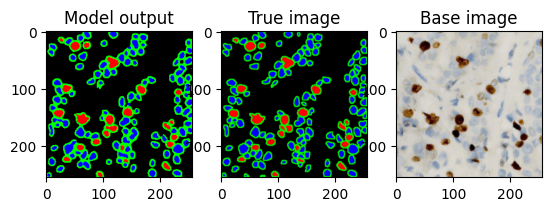

25it [00:33,  1.33s/it]


Epoch [44/50], Train Loss: 0.1648, Validation Loss: 0.3028


0it [00:00, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


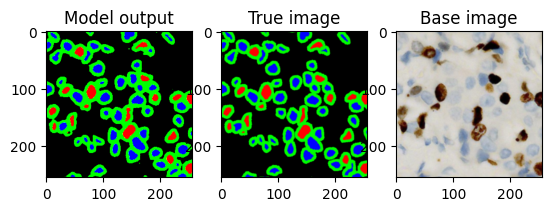

25it [00:32,  1.29s/it]


Epoch [45/50], Train Loss: 0.1581, Validation Loss: 0.3169


0it [00:00, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


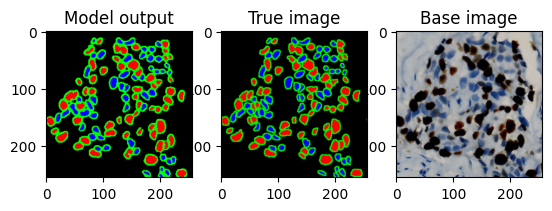

25it [00:32,  1.30s/it]


Epoch [46/50], Train Loss: 0.1591, Validation Loss: 0.3083


0it [00:00, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


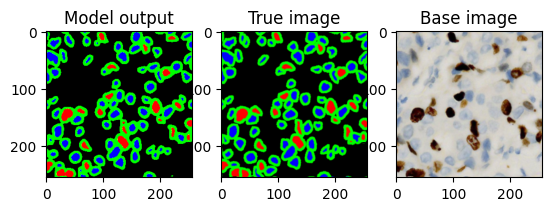

25it [00:32,  1.30s/it]


Epoch [47/50], Train Loss: 0.1516, Validation Loss: 0.3301


0it [00:00, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


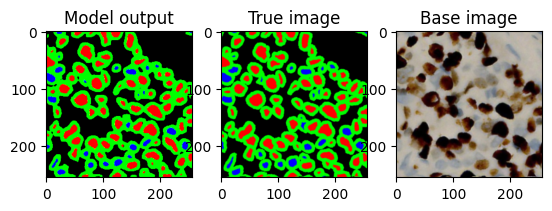

25it [00:32,  1.31s/it]


Epoch [48/50], Train Loss: 0.1570, Validation Loss: 0.3016


0it [00:00, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


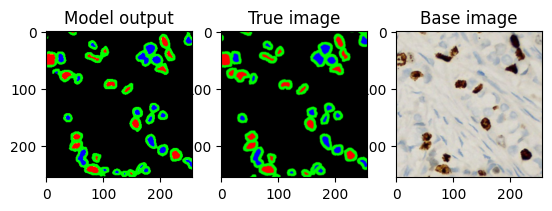

25it [00:32,  1.31s/it]


Epoch [49/50], Train Loss: 0.1566, Validation Loss: 0.3015


0it [00:00, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


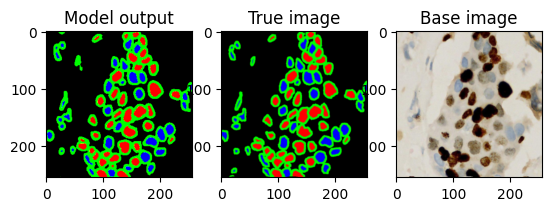

25it [00:32,  1.31s/it]


Epoch [50/50], Train Loss: 0.1526, Validation Loss: 0.3031


In [ ]:
num_epochs = 50
optimizer = torch.optim.Adam(model.parameters(), lr=2e-4)
#criterion = nn.BCEWithLogitsLoss()

for epoch in range(num_epochs):
    train_loss = train(model, train_loader, criterion, optimizer, device)
    val_loss = validate(model, val_loader, criterion, device)
    all_train_loss.append(train_loss)
    all_val_loss.append(val_loss)

    print(f'Epoch [{epoch+1}/{num_epochs}], Train Loss: {train_loss:.4f}, Validation Loss: {val_loss:.4f}')

    # Save best model
    if val_loss < best_val_loss:
        best_val_loss = val_loss
        torch.save(model.state_dict(), save_dir+'/best_model_unet1.pth')
    # if val_loss2 < best_val_loss2:
    #     best_val_loss2 = val_loss2
    #     torch.save(model2.state_dict(), save_dir+'/best_model_unet2.pth')
    # if val_loss3 < best_val_loss3:
    #     best_val_loss3 = val_loss3
    #     torch.save(model3.state_dict(), save_dir+'/best_model_unet3.pth')
    # if val_loss4 < best_val_loss4:
    #     best_val_loss4 = val_loss4
    #     torch.save(model4.state_dict(), save_dir+'/best_model_unet4.pth')
    # if val_loss5 < best_val_loss5:
    #     best_val_loss5 = val_loss5
    #     torch.save(model.state5_dict(), save_dir+'/best_model_unet5.pth')


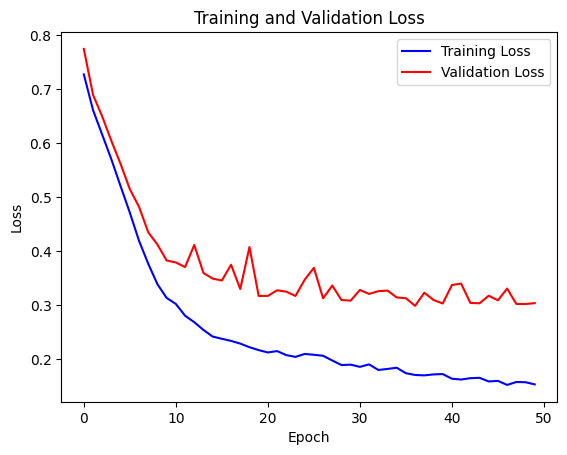

In [ ]:
plt.plot(all_train_loss, 'b', label='Training Loss')
plt.plot(all_val_loss, 'r', label='Validation Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()

In [ ]:
# Load the saved model
best_model = smp.Unet(
    encoder_name="resnet50",        # Use the ResNet-50 encoder
    encoder_weights="imagenet",     # Use the pre-trained weights from ImageNet
    classes=3,                      # The number of classes to predict (only one in this case)
)

best_model.load_state_dict(torch.load(save_dir+'/best_model_unet1.pth'))


# Set the model to evaluation mode
best_model.eval()

# Initialize variables for tracking loss and accuracy
total_loss = 0.0


# Iterate through the test set
for inputs, targets in tqdm(test_loader):
    # Pass the inputs through the model to get the predictions
    outputs = best_model(inputs)
    
    # Calculate the loss
    loss = criterion(outputs, targets)
    total_loss += loss.item()
    
# Calculate the average loss
avg_loss = total_loss / len(test_loader)

# Print the results
print('Average loss: {:.4f}'.format(avg_loss))


100%|██████████| 38/38 [08:50<00:00, 13.97s/it]

Average loss: 0.5528


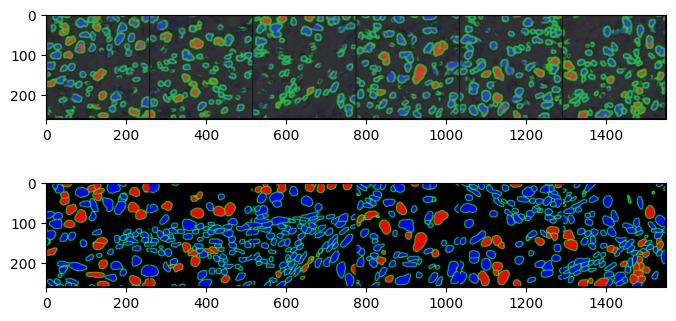

In [ ]:
# Plot the predicted images and test images side by side
fig, axs = plt.subplots(2, 1, figsize=(8, 4))


axs[0].imshow(np.transpose(torchvision.utils.make_grid(outputs, normalize=True).cpu().numpy(), (1, 2, 0)))
axs[1].imshow(np.transpose(torchvision.utils.make_grid(targets, normalize=True).cpu().numpy(), (1, 2, 0)))

plt.show()

# 3. Super resolution with diffusers

In [ ]:
import cv2
import torchvision.transforms.functional as TF

In [ ]:
model_id = "CompVis/ldm-super-resolution-4x-openimages"

# load model and scheduler
pipeline = LDMSuperResolutionPipeline.from_pretrained(model_id)
pipeline = pipeline.to(device)


Fetching 6 files:   0%|          | 0/6 [00:00<?, ?it/s]

In [ ]:
i = 3
lowres_image = y[i,:,:,:]


In [ ]:
# run pipeline in inference (sample random noise and denoise)
upscaled_image = pipeline(lowres_image.unsqueeze(0), num_inference_steps=70, eta=1).images[0]

In [ ]:
lowres_image.shape

torch.Size([3, 256, 256])

In [ ]:
upscaled_image = TF.adjust_contrast(lowres_image, 1.2)

In [ ]:
# save image
base_dir = '/content/drive/MyDrive/Columbia/Deepliif/images'
upscaled_image.save(base_dir+'/ldm_generated_image.png')



In [ ]:
image = Image.open(base_dir+'/ldm_generated_image.png')
x = TF.to_tensor(image)

upscaled_image = TF.adjust_brightness(upscaled_image, 1)
upscaled_image = TF.adjust_contrast(x, 1)


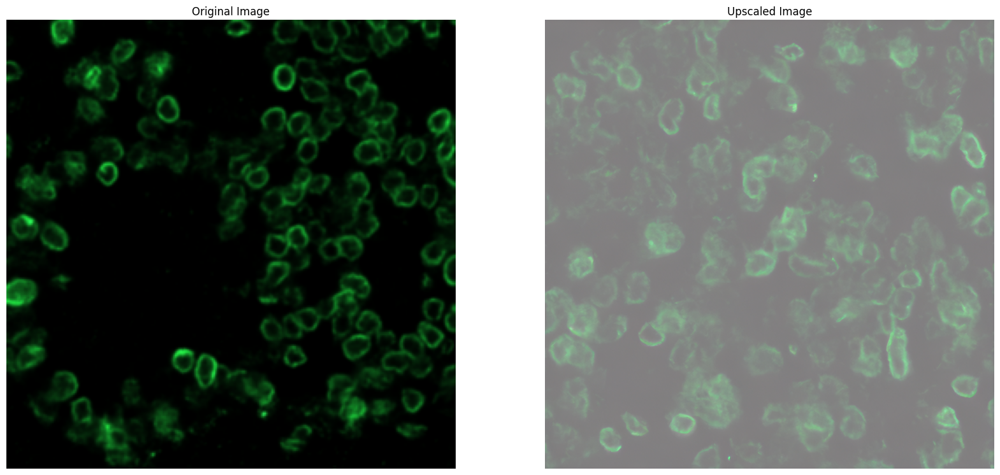

In [ ]:
# show images side by side
fig, ax = plt.subplots(1, 2, figsize=(20, 10))
ax[0].imshow(lowres_image.permute(1,2,0))
ax[0].axis('off')
ax[0].set_title("Original Image")
ax[1].imshow(upscaled_image.permute(1,2,0))
ax[1].axis('off')
ax[1].set_title("Upscaled Image")
plt.show()